In [122]:
import anndata as ad
import scanpy as sc
import episcanpy as epi
import numpy as np
import bbknn

sc.settings.set_figure_params(dpi=80, dpi_save=400)

### Loading 10x data

In [123]:
adata_10x = ad.read("atac_v1_adult_brain_fresh_5k_sparse_bin.h5ad")
adata_10x

AnnData object with n_obs × n_vars = 20000 × 546206

In [124]:
adata_10x.var_names

Index(['chrUn_GL456387 1 5000 5000 * chrUn_GL456387:1-5000',
       'chrUn_GL456387 5001 10000 5000 * chrUn_GL456387:5001-10000',
       'chrUn_GL456387 10001 15000 5000 * chrUn_GL456387:10001-15000',
       'chrUn_GL456387 15001 20000 5000 * chrUn_GL456387:15001-20000',
       'chrUn_GL456387 20001 25000 5000 * chrUn_GL456387:20001-25000',
       'chrUn_GL456382 1 5000 5000 * chrUn_GL456382:1-5000',
       'chrUn_GL456382 5001 10000 5000 * chrUn_GL456382:5001-10000',
       'chrUn_GL456382 10001 15000 5000 * chrUn_GL456382:10001-15000',
       'chrUn_GL456382 15001 20000 5000 * chrUn_GL456382:15001-20000',
       'chrUn_GL456382 20001 25000 5000 * chrUn_GL456382:20001-25000',
       ...
       'chrUn_GL456359 5001 10000 5000 * chrUn_GL456359:5001-10000',
       'chrUn_GL456359 10001 15000 5000 * chrUn_GL456359:10001-15000',
       'chrUn_GL456359 15001 20000 5000 * chrUn_GL456359:15001-20000',
       'chrUn_GL456359 20001 25000 5000 * chrUn_GL456359:20001-25000',
       'chrUn_GL45638

### filtering 10x barcodes to get closer to the expected number of cells 

In [125]:
epi.pp.filter_cells(adata_10x, min_features=500)
adata_10x

AnnData object with n_obs × n_vars = 4349 × 546206
    obs: 'nb_features'

In [126]:
epi.pp.filter_features(adata_10x, min_cells=100)
adata_10x

AnnData object with n_obs × n_vars = 4349 × 164259
    obs: 'nb_features'
    var: 'n_cells'

In [127]:
#adata10x.write('atac_v1_adult_brain_fresh_5k_sparse_bin_min500bins_min100cells.h5ad')
#adata_10x = ad.read('atac_v1_adult_brain_fresh_5k_sparse_bin_min500bins_min100cells.h5ad')

In [96]:
adata_10x

AnnData object with n_obs × n_vars = 4349 × 164259
    obs: 'nb_features'
    var: 'n_cells'

In [128]:
adata_fang = ad.read("CEMBA180312_3B_sparse_bin.h5ad")
adata_fang

AnnData object with n_obs × n_vars = 14930 × 545118

In [129]:
adata_fang.var_names

Index(['chrY 1 5000 5000 * chrY:1-5000',
       'chrY 5001 10000 5000 * chrY:5001-10000',
       'chrY 10001 15000 5000 * chrY:10001-15000',
       'chrY 15001 20000 5000 * chrY:15001-20000',
       'chrY 20001 25000 5000 * chrY:20001-25000',
       'chrY 25001 30000 5000 * chrY:25001-30000',
       'chrY 30001 35000 5000 * chrY:30001-35000',
       'chrY 35001 40000 5000 * chrY:35001-40000',
       'chrY 40001 45000 5000 * chrY:40001-45000',
       'chrY 45001 50000 5000 * chrY:45001-50000',
       ...
       'chr8 129355001 129360000 5000 * chr8:129355001-129360000',
       'chr8 129360001 129365000 5000 * chr8:129360001-129365000',
       'chr8 129365001 129370000 5000 * chr8:129365001-129370000',
       'chr8 129370001 129375000 5000 * chr8:129370001-129375000',
       'chr8 129375001 129380000 5000 * chr8:129375001-129380000',
       'chr8 129380001 129385000 5000 * chr8:129380001-129385000',
       'chr8 129385001 129390000 5000 * chr8:129385001-129390000',
       'chr8 129390001

In [130]:
# concatenating the 2 matrices
adata = adata_fang.concatenate(adata_10x)

In [131]:
annot = []
for n in adata.obs['batch']:
    if n == '0':
        annot.append('CEMBA180312_3B')
    else:
        annot.append('10X Genomics')
adata.obs['batchname'] = annot 

In [101]:
adata

AnnData object with n_obs × n_vars = 19279 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1'

In [102]:
#adata.write('merge_10x_CEMBA180312_3B_bin_raw.h5ad')
adata = ad.read('merge_10x_CEMBA180312_3B_bin_raw.h5ad')
adata

... storing 'batchname' as categorical


AnnData object with n_obs × n_vars = 19279 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1'

### processing data

In [103]:
epi.pp.binarize(adata)

In [132]:
epi.pp.filter_cells(adata, min_features=10)

In [133]:
adata

AnnData object with n_obs × n_vars = 19277 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1'

In [134]:
epi.pp.filter_features(adata, min_cells=50)

In [135]:
adata

AnnData object with n_obs × n_vars = 19277 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'

In [136]:
epi.pp.filter_features(adata, min_cells=100)

In [137]:
epi.pp.lazy(adata)

In [138]:
adata

AnnData object with n_obs × n_vars = 19277 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

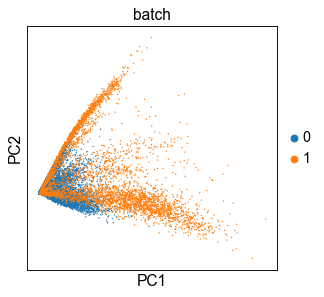

In [144]:
sc.pl.pca(adata, color='batch')

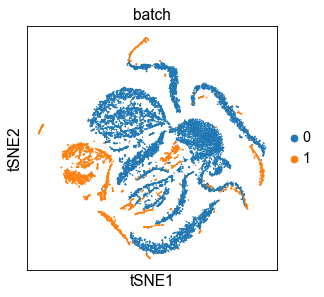

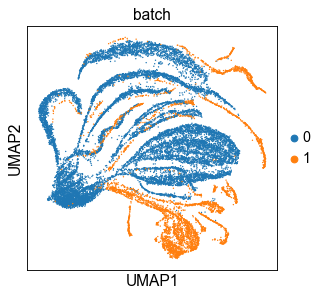

In [145]:
sc.pl.tsne(adata, color='batch')
sc.pl.umap(adata, color='batch')

In [147]:
#adata.write('merge_10x_CEMBA180312_3B_bin_pre_bbknn.h5ad')

In [148]:
adata

AnnData object with n_obs × n_vars = 19277 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'
    uns: 'pca', 'neighbors', 'umap', 'batch_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [173]:
adata = ad.read('merge_10x_CEMBA180312_3B_bin_pre_bbknn.h5ad')
adata

AnnData object with n_obs × n_vars = 19277 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [174]:
epi.pp.filter_cells(adata, min_features=1000)
adata

AnnData object with n_obs × n_vars = 13189 × 164259
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [175]:
adata2 = adata[:,adata.var['n_cells']>500]

In [176]:
adata2

View of AnnData object with n_obs × n_vars = 13189 × 54539
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [177]:
epi.pp.pca(adata2, n_comps=100)
epi.pp.neighbors(adata2, n_neighbors=15)

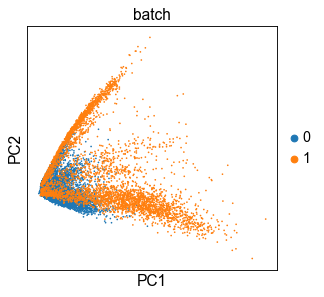

In [178]:
sc.pl.pca(adata, color='batch')

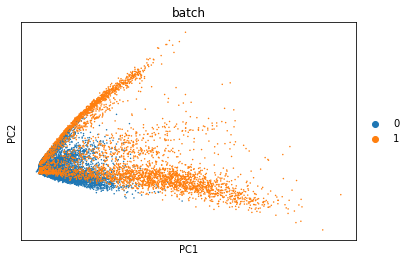

In [10]:
sc.pl.pca(adata, color='batch')

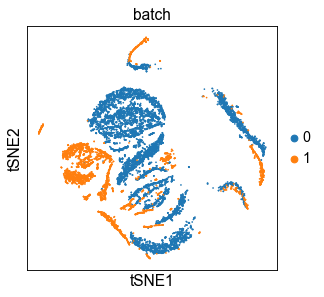

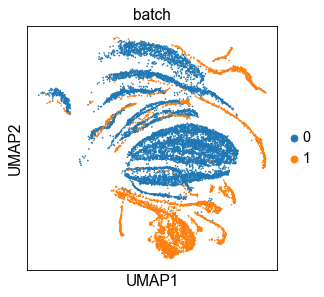

In [179]:
sc.pl.tsne(adata, color='batch')
sc.pl.umap(adata, color='batch')

In [180]:
adata2

AnnData object with n_obs × n_vars = 13189 × 54539
    obs: 'nb_features', 'batch', 'batchname'
    var: 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [ ]:
epi.pp.regress_out(adata2, 'n_counts')

In [ ]:
epi.pp.lazy(adata2, method='umap')

In [ ]:
epi.pp.pca(adata2, n_comps=100)
epi.pp.neighbors(adata2, n_neighbors=15)
sc.pl.pca(adata2, color='batch')

In [ ]:
sc.pl.tsne(adata2, color='batch')
sc.pl.umap(adata2, color='batch')

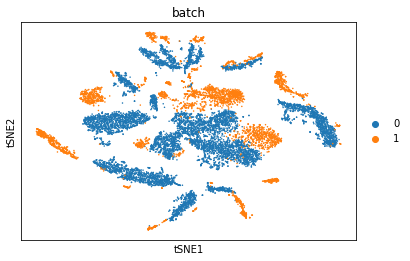

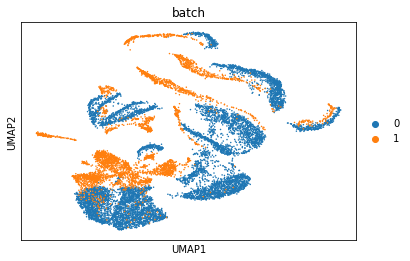

In [16]:
sc.pl.tsne(adata2, color='batch')
sc.pl.umap(adata2, color='batch')

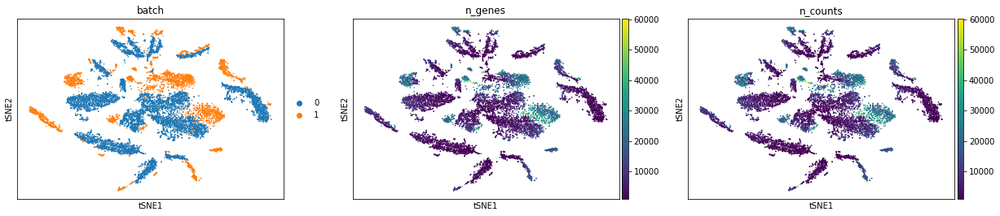

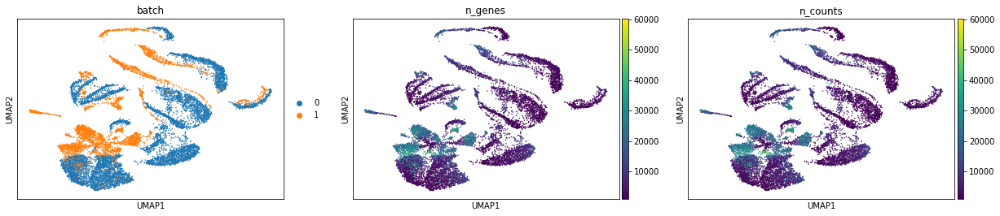

In [17]:
sc.pl.tsne(adata2, color=['batch', 'n_genes', 'n_counts'])
sc.pl.umap(adata2, color=['batch', 'n_genes', 'n_counts'])

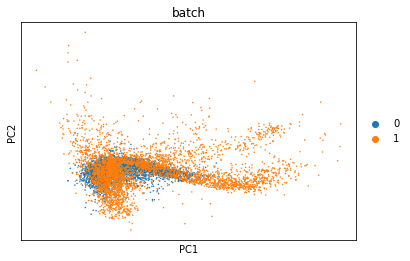

In [5]:
sc.tl.pca(adata2, n_comps=100)
sc.pl.pca(adata2, color='batch')

In [19]:
sc.settings.set_figure_params(dpi=80, dpi_save=400)

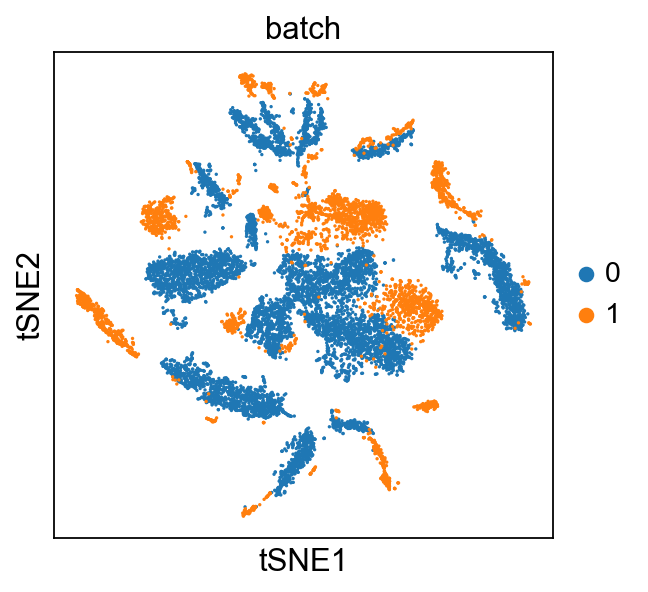

saving figure to file ./figures/umapbefore_bbknn_10x_fang312.pdf


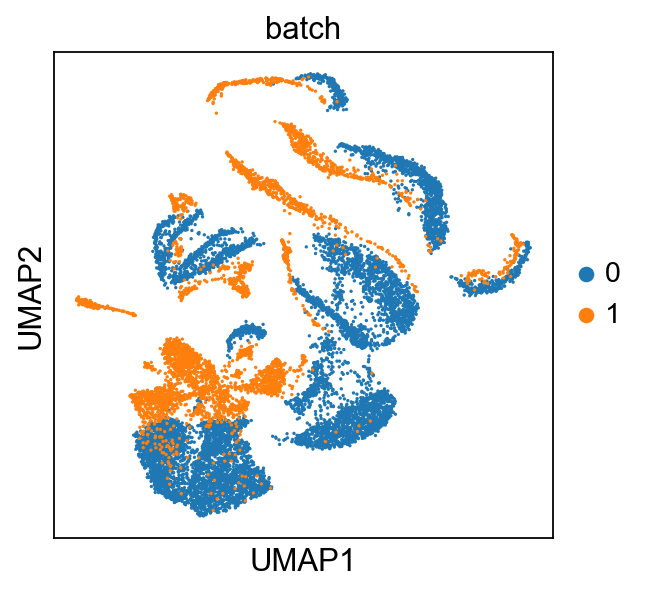

saving figure to file ./figures/umapbefore_bbknn_10x_fang312.png


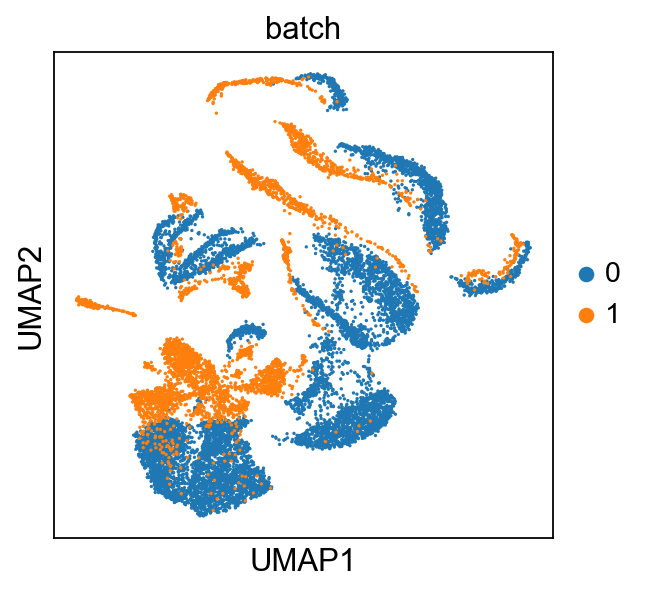

In [20]:
sc.pl.tsne(adata2, color='batch')
sc.pl.umap(adata2, color='batch', save='before_bbknn_10x_fang312.pdf')
sc.pl.umap(adata2, color='batch', save='before_bbknn_10x_fang312.png')

Trying to set attribute `.obsm` of view, making a copy.


saving figure to file ./figures/umaplouvain_10x_only.png


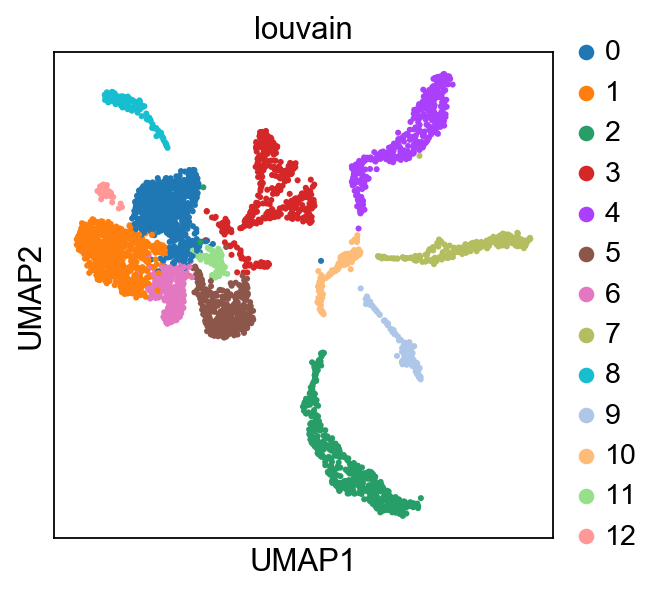

In [21]:
adata_10x = adata2[adata2.obs['batch']=='1',:]
sc.pp.pca(adata_10x, n_comps=100)
sc.pp.neighbors(adata_10x)
sc.tl.pca(adata_10x)
sc.tl.tsne(adata_10x)
sc.tl.umap(adata_10x)
sc.tl.louvain(adata_10x, resolution=0.5)
#sc.pl.pca(adata_10x, color='louvain')
#sc.pl.tsne(adata_10x, color='louvain')
sc.pl.umap(adata_10x, color='louvain', save='louvain_10x_only.png')
index = 0
annot = []
for n in adata2.obs['batch']:
    if n == '0':
        annot.append('NA')
    else:
        annot.append(adata_10x.obs['louvain'][index])
        index += 1
adata2.obs['louvain_10x'] = annot
del adata_10x

Trying to set attribute `.obsm` of view, making a copy.
... storing 'louvain_10x' as categorical


saving figure to file ./figures/umaplouvain_fang312_only.png


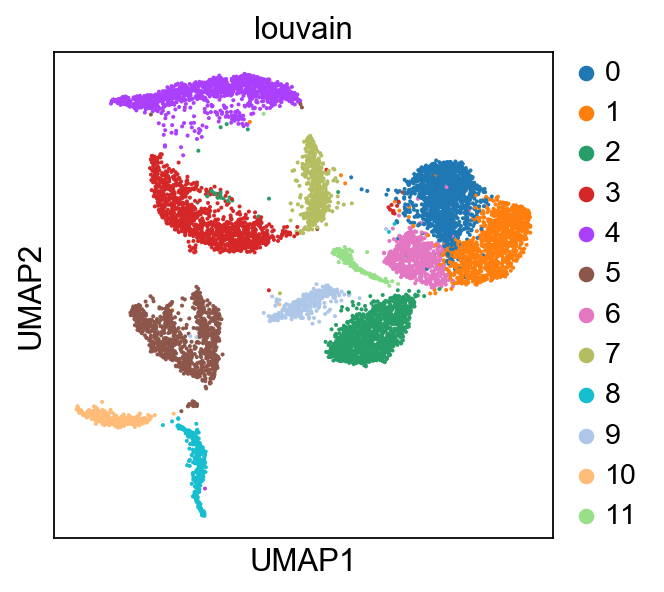

In [22]:
adata_fang = adata2[adata2.obs['batch']=='0',:]
sc.pp.pca(adata_fang, n_comps=100)
sc.pp.neighbors(adata_fang)
sc.tl.pca(adata_fang)
sc.tl.tsne(adata_fang)
sc.tl.umap(adata_fang)
sc.tl.louvain(adata_fang, resolution=0.5)
#sc.pl.pca(adata_fang, color='louvain')
#sc.pl.tsne(adata_fang, color='louvain')
sc.pl.umap(adata_fang, color='louvain', save='louvain_fang312_only.png')
index = 0
annot = []
for n in adata2.obs['batch']:
    if n == '1':
        annot.append('NA')
    else:
        annot.append(adata_fang.obs['louvain'][index])
        index += 1
adata2.obs['louvain_fang'] = annot
del adata_fang

In [23]:
adata2

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'louvain_10x_colors', 'louvain_fang_colors', 'all_independent_clusters_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

... storing 'louvain_10x' as categorical
... storing 'louvain_fang' as categorical


saving figure to file ./figures/umapbefore_bbknn_10x_fang312_clusters.png


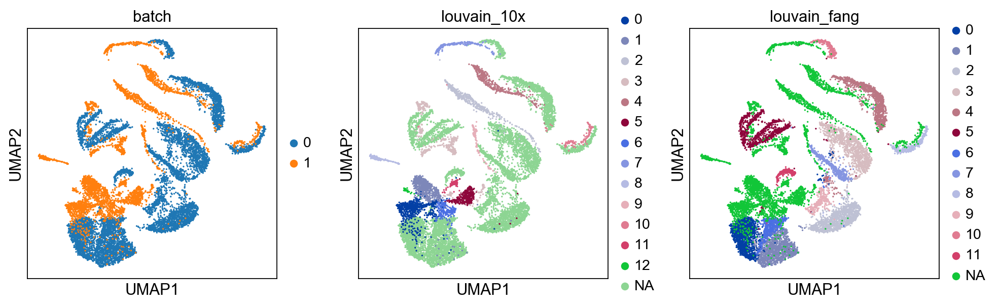

In [24]:
sc.pl.umap(adata2, color=['batch', 'louvain_10x', 'louvain_fang'],
           save='before_bbknn_10x_fang312_clusters.png')

In [25]:
all_clusters = []
for n in adata2.obs['louvain_fang']:
    if n != 'NA':
        all_clusters.append("_".join(['0', n]))
for n in adata2.obs['louvain_10x']:
    if n != 'NA':
        all_clusters.append("_".join(['1', n]))
        
adata2.obs['all_independent_clusters'] = all_clusters

In [26]:
adata2

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'louvain_10x_colors', 'louvain_fang_colors', 'all_independent_clusters_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

... storing 'all_independent_clusters' as categorical


saving figure to file ./figures/umapbefore_bbknn_10x_fang312_clusters2.png


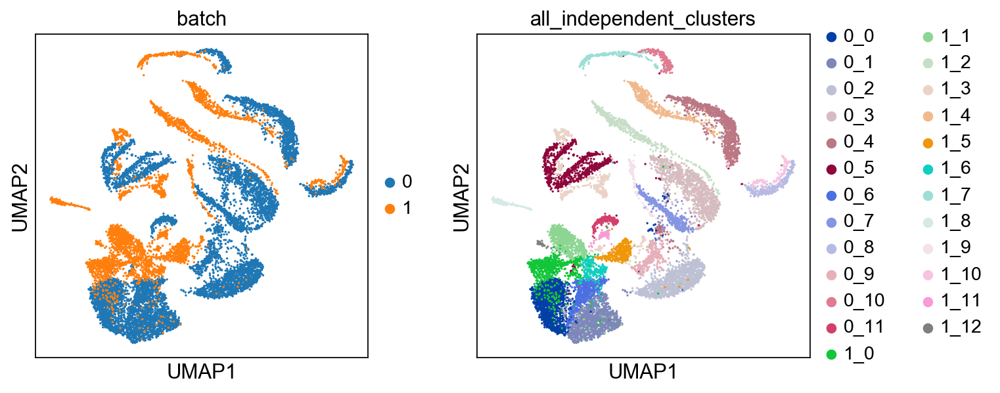

In [27]:
sc.pl.umap(adata2, color=['batch', 'all_independent_clusters'],
           save='before_bbknn_10x_fang312_clusters2.png')

In [87]:
adata2

AnnData object with n_obs × n_vars = 13189 × 54539
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'all_independent_clusters_colors', 'batch_colors', 'louvain_10x_colors', 'louvain_fang_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

## bbknn

In [29]:
adata3 = bbknn.bbknn(adata2, batch_key='batch', approx=True, metric='angular', copy=True)
epi.tl.tsne(adata3)
epi.tl.umap(adata3)
epi.tl.louvain(adata3, key_added='post_bbknn_louvain')

In [30]:
epi.tl.louvain(adata3, resolution=0.8, key_added='post_bbknn_louvain')

saving figure to file ./figures/umapbbknn_attempt1.png


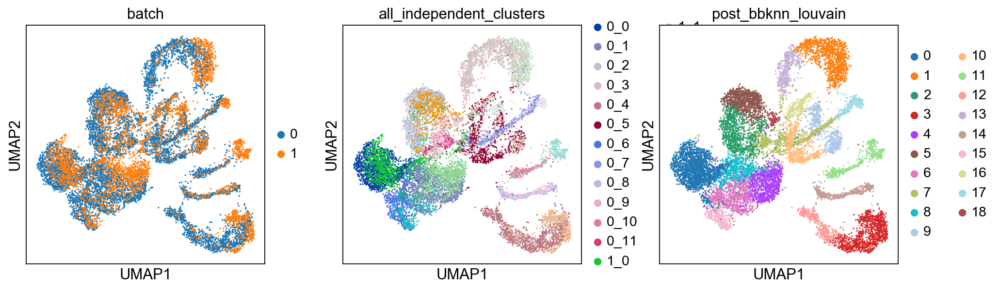

In [31]:
#epi.pl.tsne(adata3, color=['batch','all_independent_clusters', 'post_bbknn_louvain'])
epi.pl.umap(adata3, color=['batch','all_independent_clusters', 'post_bbknn_louvain'], save='bbknn_attempt1.png')

saving figure to file ./figures/umapbbknn_attempt1_1.png


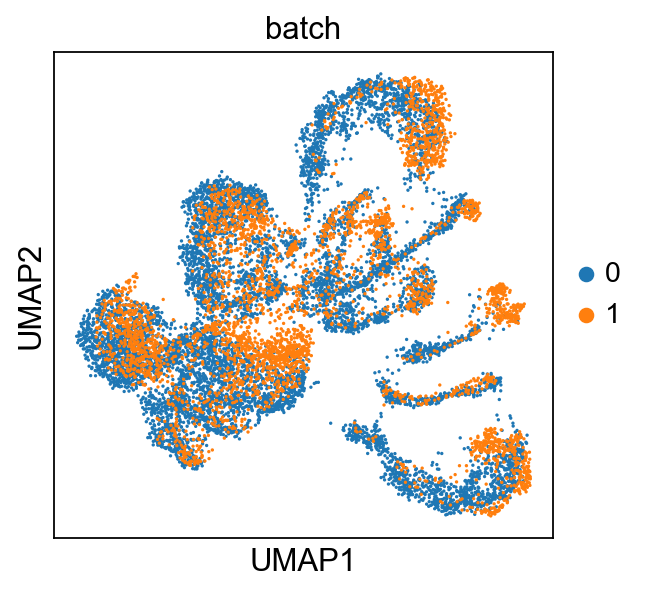

In [32]:
sc.pl.umap(adata3, color=['batch'], save='bbknn_attempt1_1.png')

saving figure to file ./figures/umapbbknn_attempt1_2.png


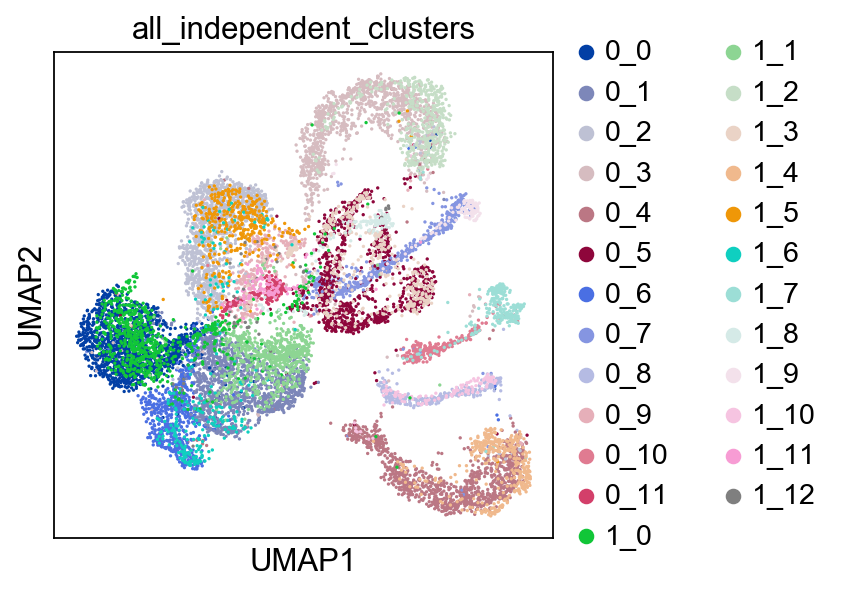

In [33]:
sc.pl.umap(adata3, color=['all_independent_clusters'], save='bbknn_attempt1_2.png')

saving figure to file ./figures/umapbbknn_attempt1_3.png


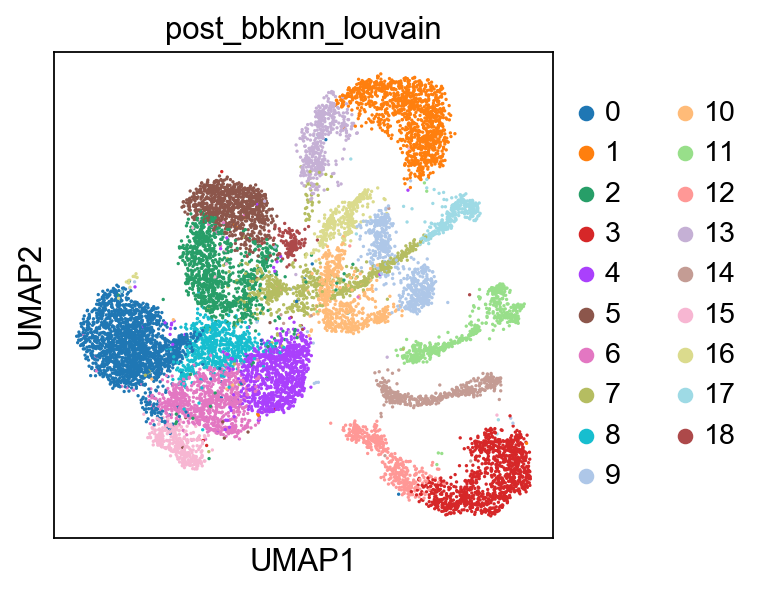

In [34]:
sc.pl.umap(adata3, color=['post_bbknn_louvain'], save='bbknn_attempt1_3.png')

In [35]:
adata3.write('10x_Fang_et_al_july_17_post_bbknn.h5ad')

In [36]:
adata3

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters', 'post_bbknn_louvain'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'louvain_10x_colors', 'louvain_fang_colors', 'all_independent_clusters_colors', 'louvain', 'post_bbknn_louvain_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [51]:
adata4 = bbknn.bbknn(adata2, batch_key='batch', neighbors_within_batch=3, n_pcs=100, approx=True, metric='angular', copy=True)
epi.tl.tsne(adata4)
epi.tl.umap(adata4)

In [52]:
epi.tl.louvain(adata4, resolution=1, key_added='post_bbknn_louvain')

saving figure to file ./figures/umapbbknn_attempt2.png


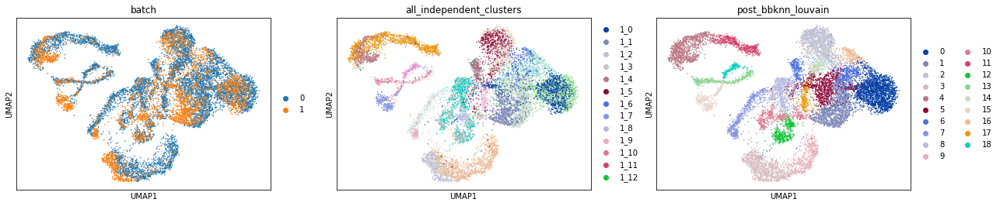

In [63]:
sc.pl.umap(adata4, color=['batch','all_independent_clusters', 'post_bbknn_louvain'], save='bbknn_attempt2.png')

In [68]:
del adata4

In [59]:
adata5 = bbknn.bbknn(adata2, batch_key='batch', neighbors_within_batch=5,
                     n_pcs=100, approx=True, metric='angular',
                     trim=None , copy=True)
epi.tl.tsne(adata5)
epi.tl.umap(adata5)

In [60]:
epi.tl.louvain(adata5, resolution=1, key_added='post_bbknn_louvain')

saving figure to file ./figures/umapbbknn_attempt3.png


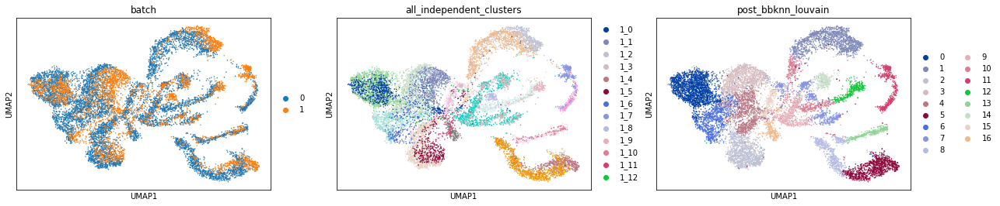

In [64]:
sc.pl.umap(adata5, color=['batch','all_independent_clusters', 'post_bbknn_louvain'], save='bbknn_attempt3.png')

In [67]:
del adata5

In [69]:
adata6 = bbknn.bbknn(adata2, batch_key='batch', neighbors_within_batch=3,
                     approx=True, metric='euclidean',
                     trim=None , copy=True)
epi.tl.tsne(adata6)
epi.tl.umap(adata6)

In [70]:
epi.tl.louvain(adata6, resolution=1, key_added='post_bbknn_louvain')

saving figure to file ./figures/umapbbknn_attempt4.png


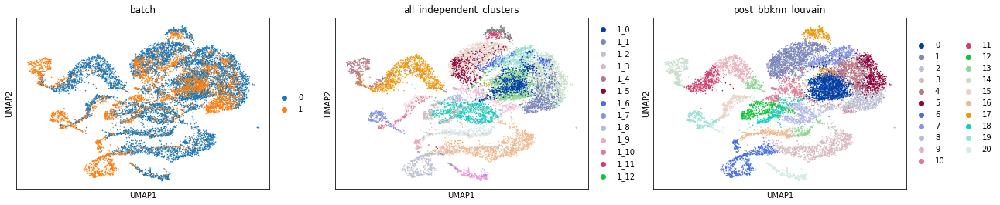

In [71]:
sc.pl.umap(adata6, color=['batch','all_independent_clusters', 'post_bbknn_louvain'], save='bbknn_attempt4.png')

In [ ]:
del adata6

In [76]:
adata7 = bbknn.bbknn(adata2, batch_key='batch', neighbors_within_batch=3,
                     approx=True, metric='hamming',
                     trim=None , copy=True)
epi.tl.tsne(adata7)
epi.tl.umap(adata7)

In [77]:
epi.tl.louvain(adata7, resolution=1, key_added='post_bbknn_louvain')

saving figure to file ./figures/umapbbknn_attempt5.png


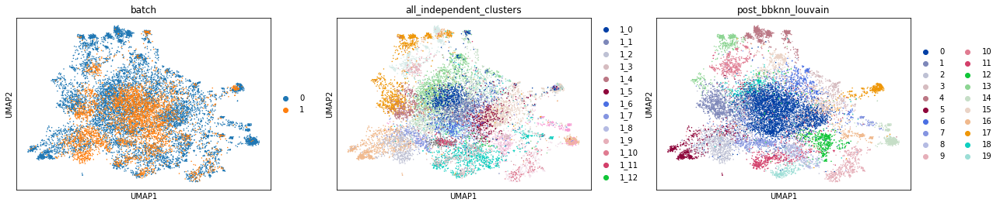

In [78]:
sc.pl.umap(adata7, color=['batch','all_independent_clusters', 'post_bbknn_louvain'], save='bbknn_attempt5.png')

In [79]:
del adata7

## Cell type identification

In [3]:
import anndata as ad
import scanpy.api as sc
import episcanpy.api as epi
import numpy as np
import bbknn


/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


/Volumes/july_2019/snapatack


In [4]:
adata3 = ad.read('10x_Fang_et_al_july_17_post_bbknn.h5ad')

In [37]:
adata3

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters', 'post_bbknn_louvain'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'batch_colors', 'neighbors', 'pca', 'louvain_10x_colors', 'louvain_fang_colors', 'all_independent_clusters_colors', 'louvain', 'post_bbknn_louvain_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

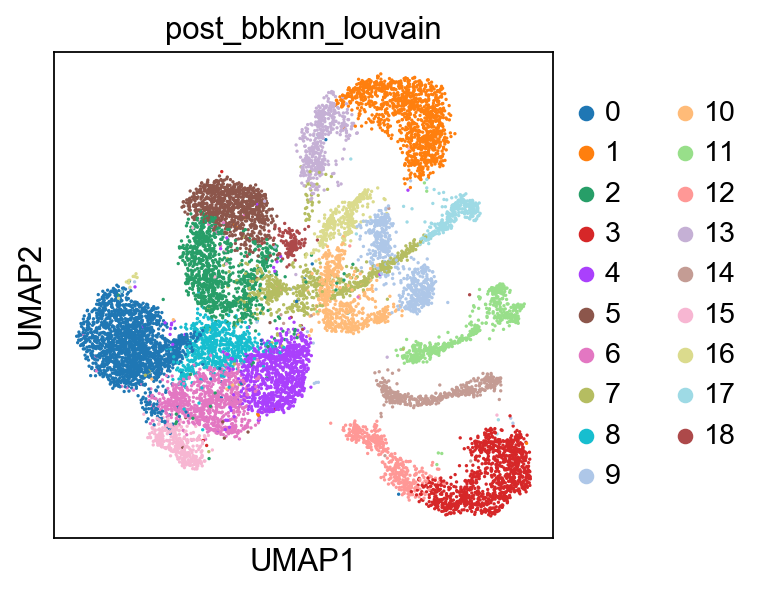

In [38]:
sc.pl.umap(adata3, color='post_bbknn_louvain')

In [39]:
new_annot = []
for n in adata3.obs['post_bbknn_louvain']:
    if n in ['1', '13']:
        new_annot.append('1')
    elif n in ['3', '12']:
        new_annot.append('3')
    elif n in ['7', '17']:
        new_annot.append('7')
    else:
        new_annot.append(n)
adata3.obs['post_bbknn_louvain2'] = new_annot

... storing 'post_bbknn_louvain2' as categorical


saving figure to file ./figures/umapfinal_louvain_post_bbknn.png


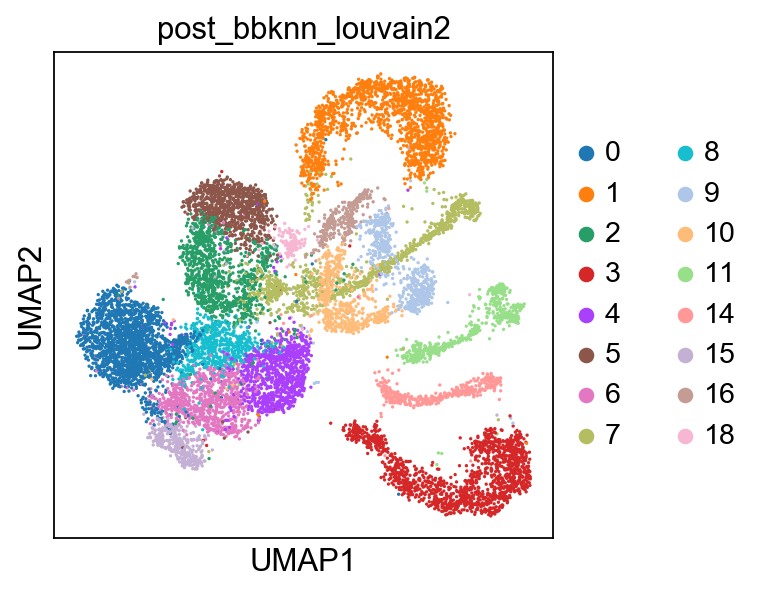

In [40]:
sc.pl.umap(adata3, color=['post_bbknn_louvain2'], save="final_louvain_post_bbknn.png")

In [41]:
epi.tl.rank_genes_groups(adata3, 'post_bbknn_louvain2')

/anaconda3/lib/python3.6/site-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


In [42]:
print(adata3.uns['rank_genes_groups'].keys())
windows = adata3.uns['rank_genes_groups']['names'].tolist()
windows = [list(w) for w in windows]

dict_keys(['params', 'scores', 'names', 'logfoldchanges', 'pvals', 'pvals_adj'])


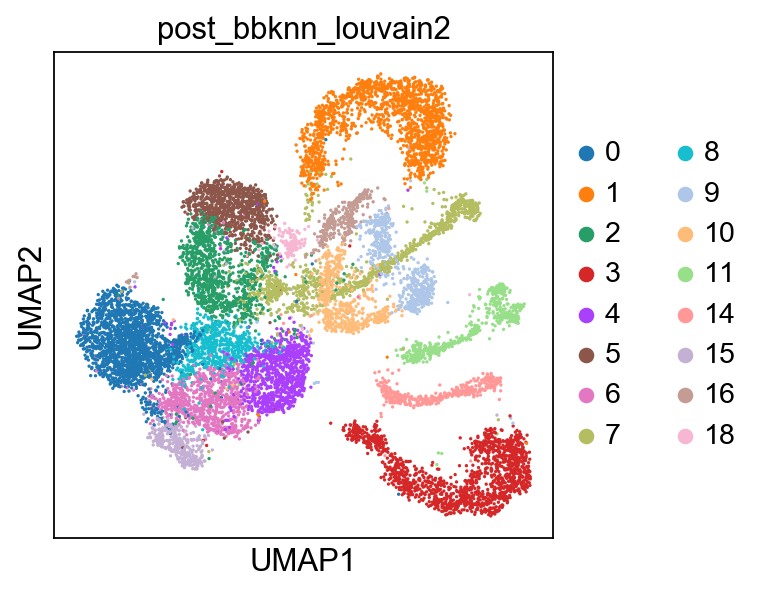

saving figure to file ./figures/umaptop_marker_for_each_final_cluster_post_bbknn.png


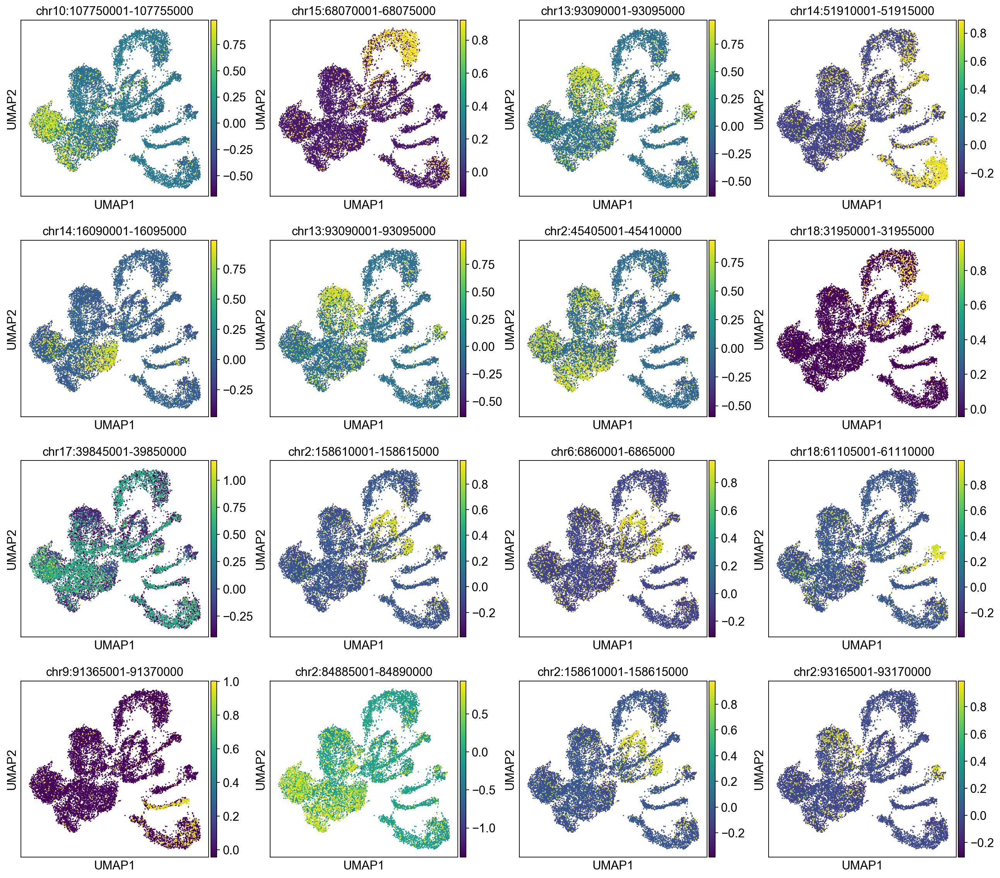

In [43]:
sc.pl.umap(adata3, color=['post_bbknn_louvain2'])
sc.pl.umap(adata3, color=windows[0], save='top_marker_for_each_final_cluster_post_bbknn.png')

In [62]:
windows[0]

['chr10:107750001-107755000',
 'chr15:68070001-68075000',
 'chr13:93090001-93095000',
 'chr14:51910001-51915000',
 'chr14:16090001-16095000',
 'chr13:93090001-93095000',
 'chr2:45405001-45410000',
 'chr18:31950001-31955000',
 'chr17:39845001-39850000',
 'chr2:158610001-158615000',
 'chr6:6860001-6865000',
 'chr18:61105001-61110000',
 'chr9:91365001-91370000',
 'chr2:84885001-84890000',
 'chr2:158610001-158615000',
 'chr2:93165001-93170000']

In [66]:
adata3.write('ready_for_cell_type_id.h5ad')

## Load the Fang replicate

In [ ]:
adata_fang2 = ad.read("CEMBA180308_3B_sparse_bin.h5ad")

In [ ]:
with open('/Volumes/july_2019/snapatack/CEMBA180308_3B_5kbin.txt') as f:
    bin_fang = f.readlines()
bin_fang = bin_fang[1:]
bin_fang = [n[:-1].split(' * ')[-1] for n in bin_fang]
adata_fang.var_names = bin_fang

keep = []
bin_10x = adata_10x.var_names.tolist()
for n2 in bin_fang:
    if n2 in bin_10x:
        keep.append('keep')
    else:
        keep.append('discard')
        
adata_fang2.var['overlap10x'] = keep
adata_fang2 = adata_fang2[:,adata_fang2.var['overlap10x']=='keep']
adata_fang2

In [ ]:
adata = adata.concatenate(adata_fang2)

# Cell type ID

In [100]:
import anndata as ad
import scanpy.api as sc
import episcanpy.api as epi
import numpy as np
import bbknn

%cd /Volumes/july_2019/snapatack

sc.settings.set_figure_params(dpi=80, dpi_save=400)



/Volumes/july_2019/snapatack


In [5]:
adata = sc.read('/Volumes/july_2019/snapatack/start_from_here_for_cell_id_july_17.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters', 'post_bbknn_louvain', 'post_bbknn_louvain2'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'all_independent_clusters_colors', 'batch_colors', 'louvain', 'louvain_10x_colors', 'louvain_fang_colors', 'neighbors', 'pca', 'post_bbknn_louvain2_colors', 'post_bbknn_louvain_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [10]:
print(adata.uns['rank_genes_groups'].keys())
windows = adata.uns['rank_genes_groups']['names'].tolist()
windows = [list(w) for w in windows]
windows_all = []
for w in windows:
    windows_all += w

dict_keys(['logfoldchanges', 'names', 'params', 'pvals', 'pvals_adj', 'scores'])


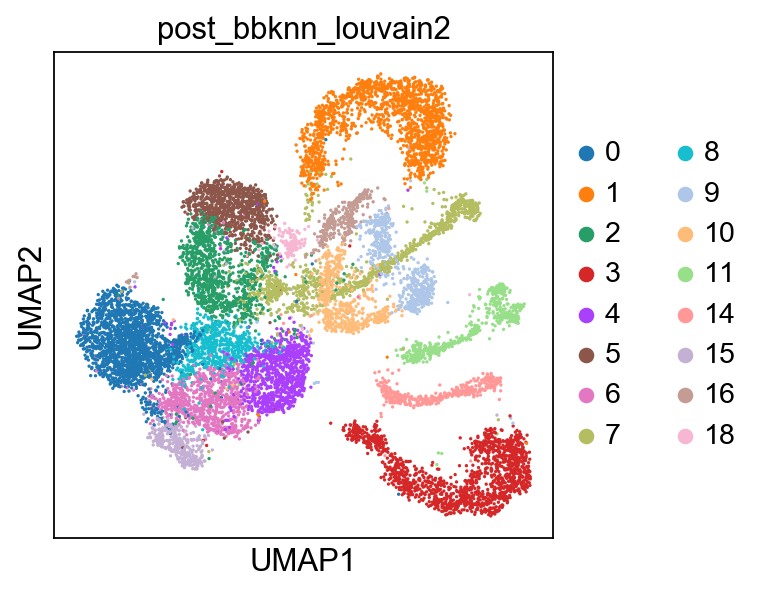

saving figure to file ./figures/umaptop_marker_for_each_final_cluster_post_bbknn.png


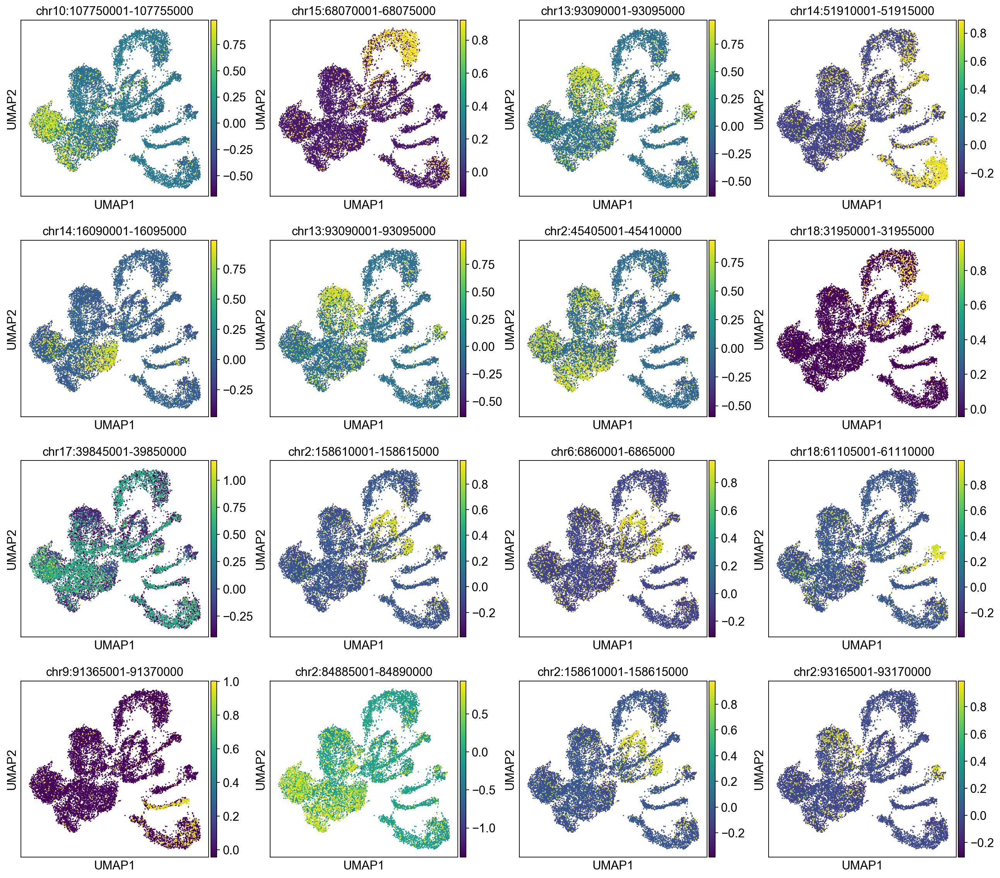

In [8]:
sc.pl.umap(adata, color=['post_bbknn_louvain2'])
sc.pl.umap(adata, color=windows[0], save='top_marker_for_each_final_cluster_post_bbknn.png')

In [ ]:
Neurod2 11:98325415-98329648

In [9]:
Neurod2="chr11:98325415-98329648"
Fabp7='chr10:57784923-57786812'

chr10:53500001-53505000
chr10:59010001-59015000
chr10:5875001-5880000
chr10:56980001-56985000
chr10:52700001-52705000


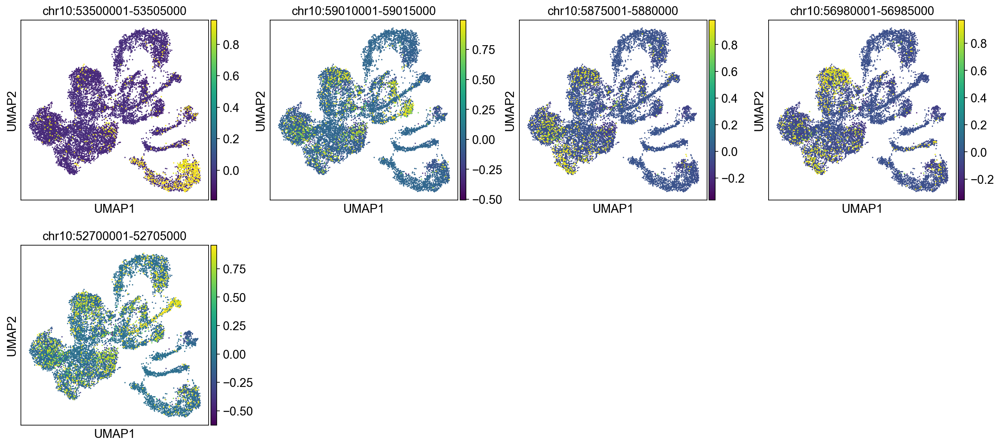

In [17]:
color_m = []
for w in windows_all:
    if 'chr10:5' in w:
        print(w)
        color_m.append(w)
sc.pl.umap(adata, color=color_m)

In [27]:
with open('/Users/anna.danese/Desktop/july12_2019/mmGRCm38.93.ERCC92.gtf') as f:
    gtf_raw = f.readlines()
gtf = []
for line in gtf_raw:
    if 'ERCC' not in line:
        if line[0] != '#':
            gtf.append(line[:-2].split('\t'))
del gtf_raw

gtf_dic = {}
for line in gtf:
    if line[0] not in gtf_dic.keys():
        gtf_dic[line[0]] = [line]
    else:
        gtf_dic[line[0]].append(line)
del gtf

In [72]:
EXTENSION = 10000
markers = []
for w in windows_all:
    curr_m = []
    w2 = w.split(':')
    chrom = w2[0][3:]
    w2 = w2[1].split('-')
    w2 = [int(x) for x in w2]
    for gene in gtf_dic[chrom]:
        start = int(gene[3])-EXTENSION
        end = int(gene[4])+EXTENSION
        if (w2[0] < start < w2[1]) or (w2[0] < end < w2[1]):
            gene_name = gene[-1]
            for n in gene[-1].split(';'):
                if 'gene_name' in n:
                    gene_name = n
            curr_m.append([w, gene_name])
    if curr_m != []:
        markers += curr_m
markers = [list(x) for x in set(tuple(x) for x in markers)]

In [87]:
genes = []
for n in markers:
    genes.append(n[1].split('"')[1])

In [63]:
len(windows_all)

1600

In [81]:
len(markers)

1056

In [88]:
len(genes)

1056

In [132]:
len(set(genes))

984

In [126]:
m = 'Slc17a7'
for line in markers:
    if m in line[1]:
        print(line)

m = 'Gad2'
for line in markers:
    if m in line[1]:
        print(line)

['chr7:45165001-45170000', ' gene_name "Slc17a7"']
['chr2:22620001-22625000', ' gene_name "Gad2"']


saving figure to file ./figures/umapinhibitory_excitatory_neurons.png


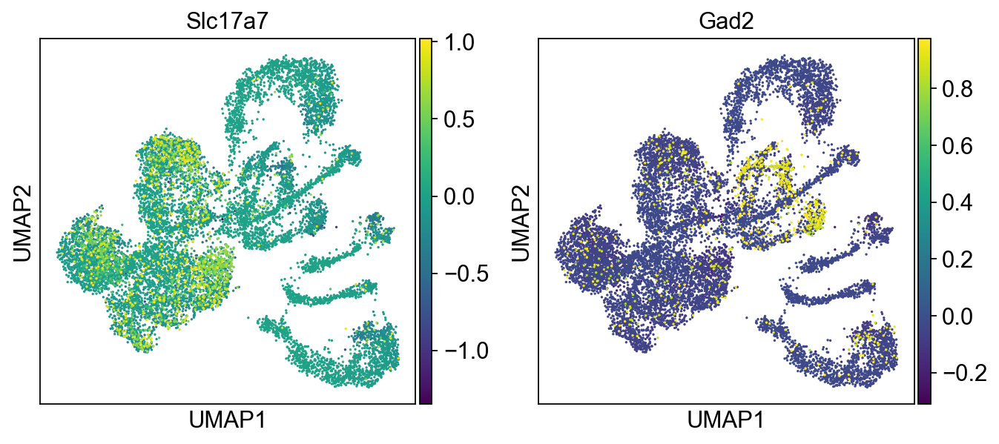

In [127]:
sc.pl.umap(adata,
           color=['chr7:45165001-45170000', 'chr2:22620001-22625000'],
           title=['Slc17a7', 'Gad2'],
           save='inhibitory_excitatory_neurons.png')

['chr1:172270001-172275000', ' gene_name "Atp1a2"']
['chr1:172280001-172285000', ' gene_name "Atp1a2"']
['chr1:172295001-172300000', ' gene_name "Atp1a2"']
['chr1:172300001-172305000', ' gene_name "Atp1a2"']
['chr2:13570001-13575000', ' gene_name "Vim"']
saving figure to file ./figures/umapastrocytes.png


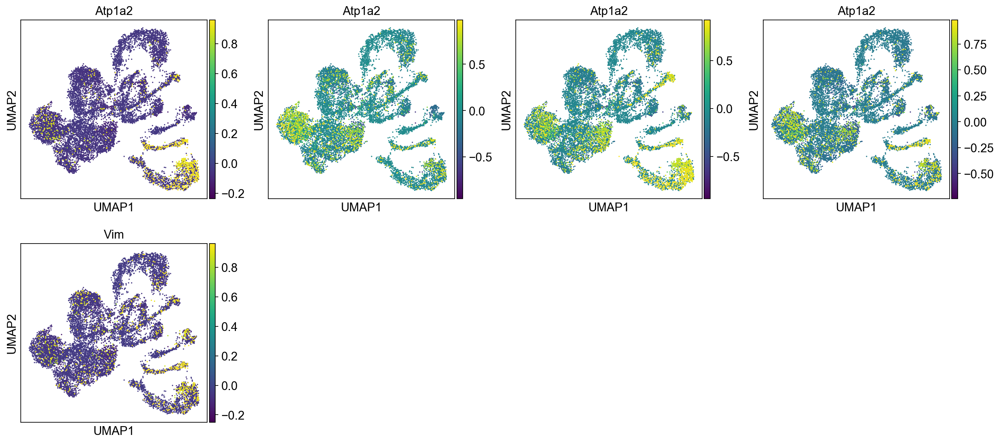

In [175]:
astrocytes = ['Ndrg2','S1pr1','Atp1a2','1110006G14Rik','Gas1',
              'Aldh1l1','Gja1','Slc01c1','S100B','Gfap',
             'Vim', 'Gfap']
color_m= []
title_m = []
for m in astrocytes:
    for line in markers:
        if m in line[1]:
            print(line)
            color_m.append(line[0])
            title_m.append(line[1].split('"')[1])
            
sc.pl.umap(adata,
           color=color_m,
           title=title_m,
           save='astrocytes.png')

['chr12:113010001-113015000', ' gene_name "Pacs2"']
saving figure to file ./figures/umapoligodendrocytes.png


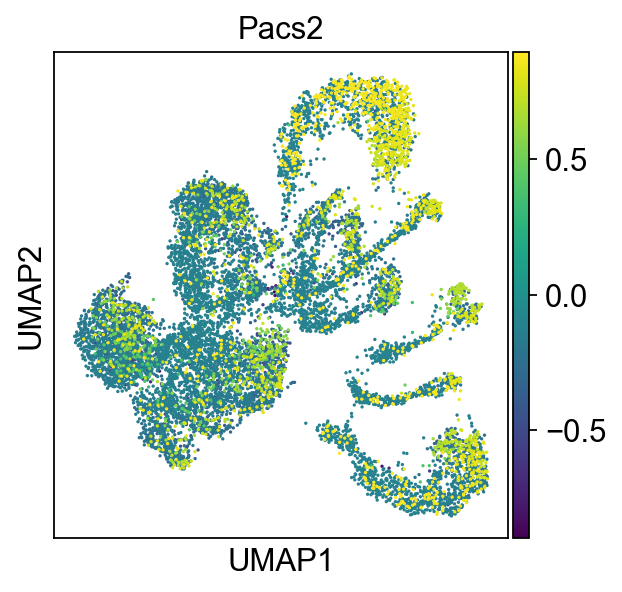

In [129]:
oligodendrocytes =['Efnb3','Gm16834','9330188P03Rik','Phdb1','Pacs2','Mag','Mog','Man1','Gm21984']
color_m= []
title_m = []
for m in oligodendrocytes:
    for line in markers:
        if m in line[1]:
            print(line)
            color_m.append(line[0])
            title_m.append(line[1].split('"')[1])
sc.pl.umap(adata,
           color=color_m,
           title=title_m,
           save='oligodendrocytes.png')

['chr6:41550001-41555000', ' gene_name "Trbj2-4"']
['chr5:122400001-122405000', ' gene_name "Arpc3"']
['chr2:102620001-102625000', ' gene_name "Pamr1"']
['chr6:15185001-15190000', ' gene_name "Foxp2"']
['chr1:37365001-37370000', ' gene_name "Inpp4a"']
['chr6:41550001-41555000', ' gene_name "Trbj2-1"']
['chr2:156670001-156675000', ' gene_name "Dlgap4"']
['chr6:41550001-41555000', ' gene_name "Trbj2-2"']
['chr4:98075001-98080000', ' gene_name "Nfia"']
saving figure to file ./figures/umapmicroglia.png


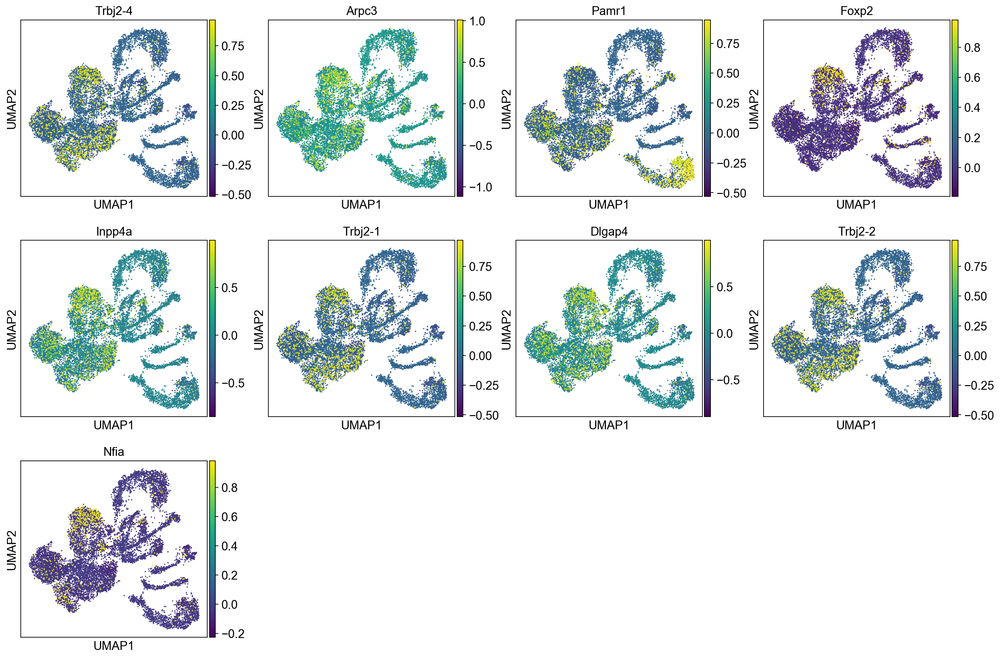

In [130]:
microglia = ['Nab1','Trbj2-4','Nrxn3','Arpc3','Gm960','Pamr1','Foxp2','Inpp4a','Trbj2-1',
             'Dlgap4','Gpr21','Wnt9a','Skap1','Trbj2-2','Cpa6','Nfia','A630023P12Rik','Neu2','Stat1']
color_m= []
title_m = []
for m in microglia:
    for line in markers:
        if m in line[1]:
            print(line)
            color_m.append(line[0])
            title_m.append(line[1].split('"')[1])
sc.pl.umap(adata,
           color=color_m,
           title=title_m,
           save='microglia.png')

['chr4:135430001-135435000', ' gene_name "Rcan3"']
['chr2:71535001-71540000', ' gene_name "Dlx2"']
['chr2:71530001-71535000', ' gene_name "Dlx2"']
['chr17:72925001-72930000', ' gene_name "Lbh"']
['chr6:8955001-8960000', ' gene_name "Nxph1"']
['chr5:35915001-35920000', ' gene_name "Afap1"']
['chr5:35950001-35955000', ' gene_name "Afap1"']
['chr5:35985001-35990000', ' gene_name "Afap1"']
['chr8:22960001-22965000', ' gene_name "Ank1"']
['chr9:41060001-41065000', ' gene_name "Ubash3b"']
['chr3:34655001-34660000', ' gene_name "Sox2ot"']
['chr3:34640001-34645000', ' gene_name "Sox2ot"']
['chr3:34645001-34650000', ' gene_name "Sox2ot"']
['chr3:34660001-34665000', ' gene_name "Sox2ot"']
saving figure to file ./figures/umapinhibitory.png


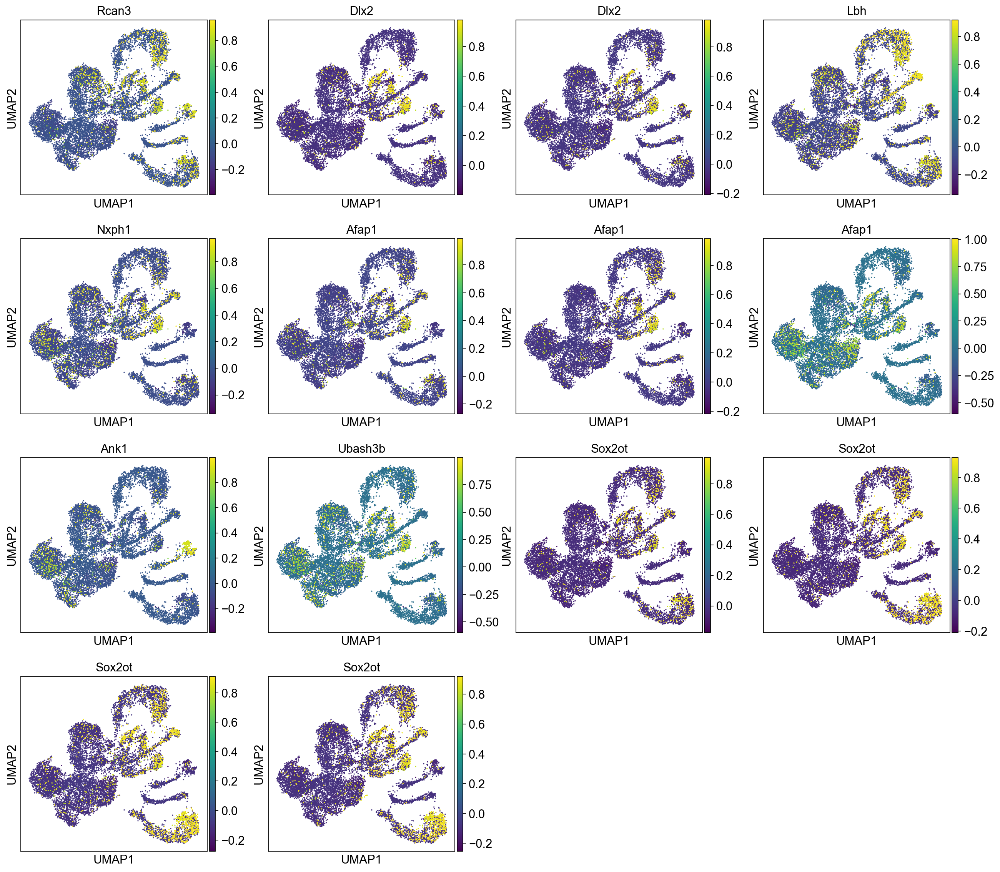

In [131]:
inhibitory = ['Rasgrp2','Btbd11','Rcan3','Dlx2','Igsf3','Tox3','Npas3','G0s2','Tubb2b',
              'Ankrd55','Igf1','Rbms3','Vwc2','Tspan2','Maf','Erbb4','Lbh','Sema4g',
              'Ptprz1','Rnd2','Nrip2','Nxph1','Mafb','Fam46a','Grik1','Erbb2ip','Snx8',
              'Afap1','Nacc2','Ank1','Ubash3b','Zfp467','Ptprm','Map3k1','Arl4c','Sox2ot',
              'Dpysl5']
color_m= []
title_m = []
for m in inhibitory:
    for line in markers:
        if m in line[1]:
            print(line)
            color_m.append(line[0])
            title_m.append(line[1].split('"')[1])
sc.pl.umap(adata,
           color=color_m,
           title=title_m,
           save='inhibitory.png')

Trying to set attribute `.obsm` of view, making a copy.


saving figure to file ./figures/umaplouvain_fang312_only2.png


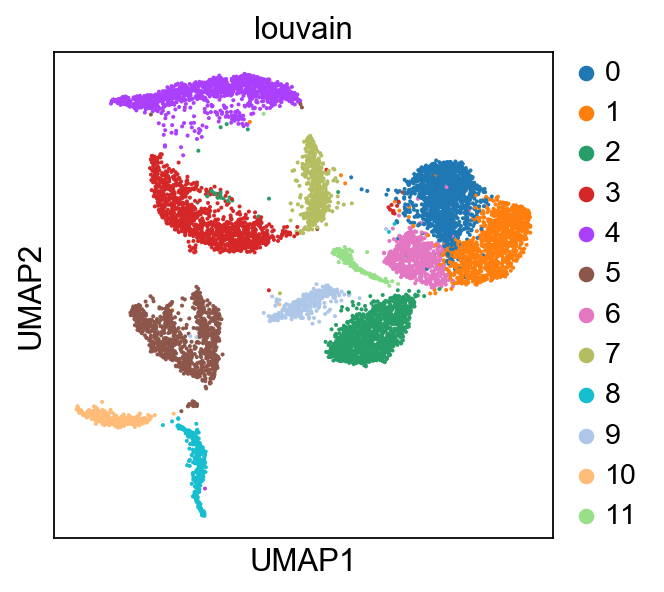

In [141]:
adata_fang = adata2[adata2.obs['batch']=='0',:]
sc.pp.pca(adata_fang, n_comps=100)
sc.pp.neighbors(adata_fang)
sc.tl.pca(adata_fang)
sc.tl.tsne(adata_fang)
sc.tl.umap(adata_fang)
sc.tl.louvain(adata_fang, resolution=0.5)
#sc.pl.pca(adata_fang, color='louvain')
#sc.pl.tsne(adata_fang, color='louvain')
sc.pl.umap(adata_fang, color='louvain', save='louvain_fang312_only2.png')
index = 0
annot = []
for n in adata2.obs['batch']:
    if n == '1':
        annot.append('NA')
    else:
        annot.append(adata_fang.obs['louvain'][index])
        index += 1
adata2.obs['louvain_fang'] = annot

saving figure to file ./figures/umaplouvain_fangmarkers_fang.png


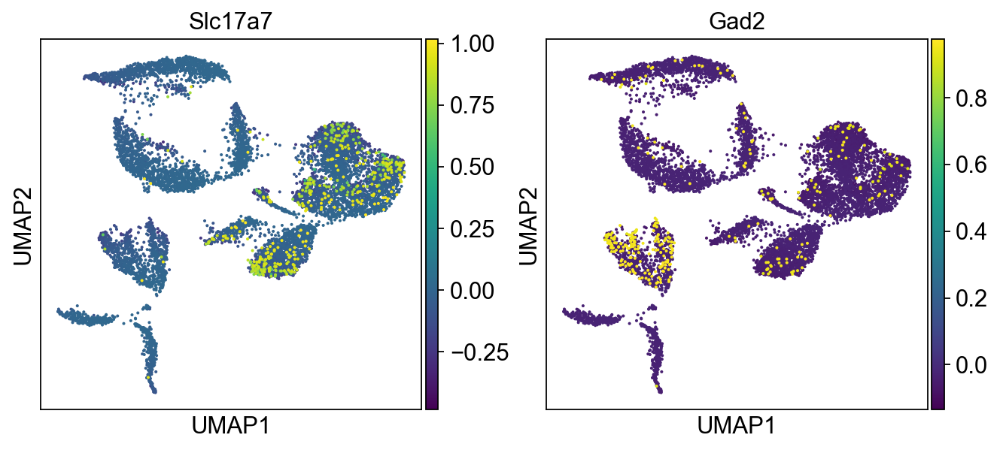

In [143]:
sc.pl.umap(adata_fang, color=['chr7:45165001-45170000', 'chr2:22620001-22625000'],
           title=['Slc17a7', 'Gad2'],
           save='louvain_fangmarkers_fang.png')

In [ ]:
['chr7:45165001-45170000', ' gene_name "Slc17a7"']
['chr2:22620001-22625000', ' gene_name "Gad2"']

Trying to set attribute `.obsm` of view, making a copy.
... storing 'louvain_fang' as categorical


saving figure to file ./figures/umaplouvain_10x_only2.png


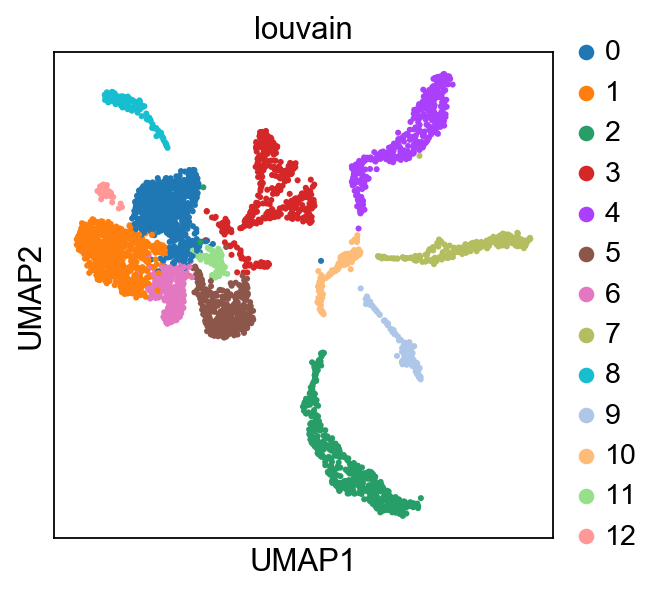

In [144]:
adata_10x = adata2[adata2.obs['batch']=='1',:]
sc.pp.pca(adata_10x, n_comps=100)
sc.pp.neighbors(adata_10x)
sc.tl.pca(adata_10x)
sc.tl.tsne(adata_10x)
sc.tl.umap(adata_10x)
sc.tl.louvain(adata_10x, resolution=0.5)
#sc.pl.pca(adata_10x, color='louvain')
#sc.pl.tsne(adata_10x, color='louvain')
sc.pl.umap(adata_10x, color='louvain', save='louvain_10x_only2.png')
index = 0
annot = []
for n in adata2.obs['batch']:
    if n == '0':
        annot.append('NA')
    else:
        annot.append(adata_10x.obs['louvain'][index])
        index += 1
adata2.obs['louvain_10x'] = annot

saving figure to file ./figures/umaplouvain_10x_markers.png


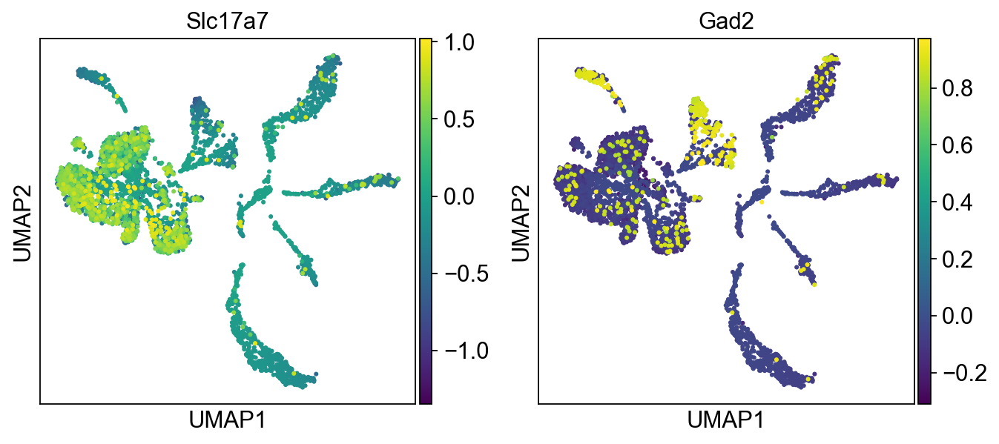

In [145]:
sc.pl.umap(adata_10x, color=['chr7:45165001-45170000', 'chr2:22620001-22625000'],
           title=['Slc17a7', 'Gad2'],
           save='louvain_10x_markers.png')

In [146]:
adata

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters', 'post_bbknn_louvain', 'post_bbknn_louvain2'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'all_independent_clusters_colors', 'batch_colors', 'louvain', 'louvain_10x_colors', 'louvain_fang_colors', 'neighbors', 'pca', 'post_bbknn_louvain2_colors', 'post_bbknn_louvain_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

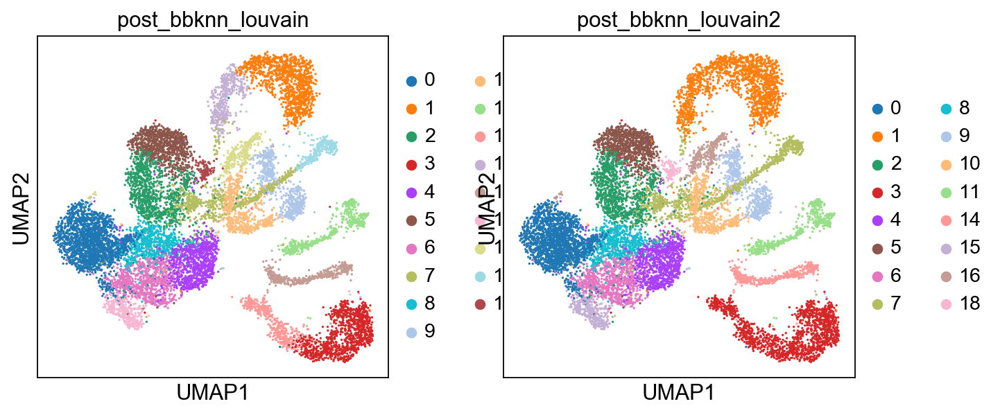

In [147]:
sc.pl.umap(adata, color=['post_bbknn_louvain2'])

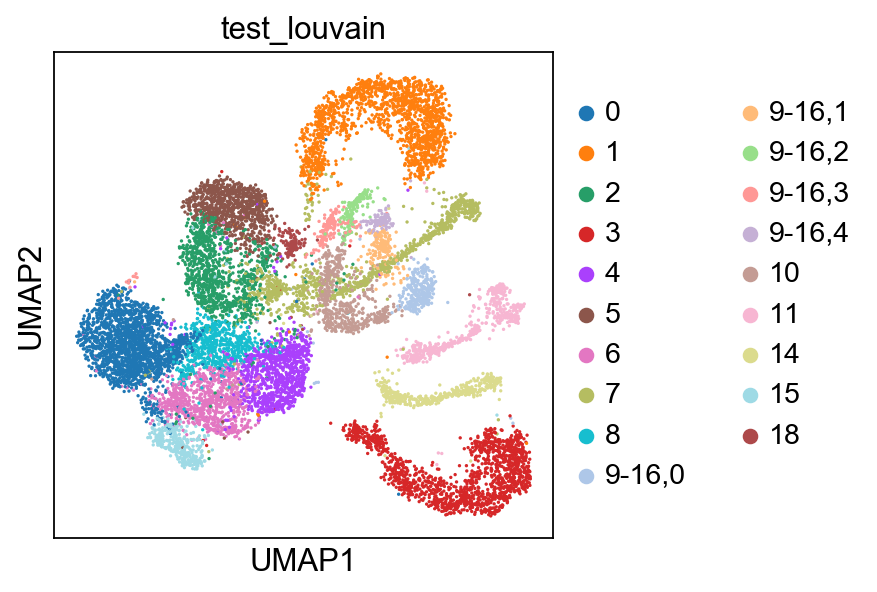

In [164]:
sc.tl.louvain(adata, resolution=0.5, restrict_to=['post_bbknn_louvain2', ['9', '16']],
             key_added='test_louvain')
sc.pl.umap(adata, color=['test_louvain'])

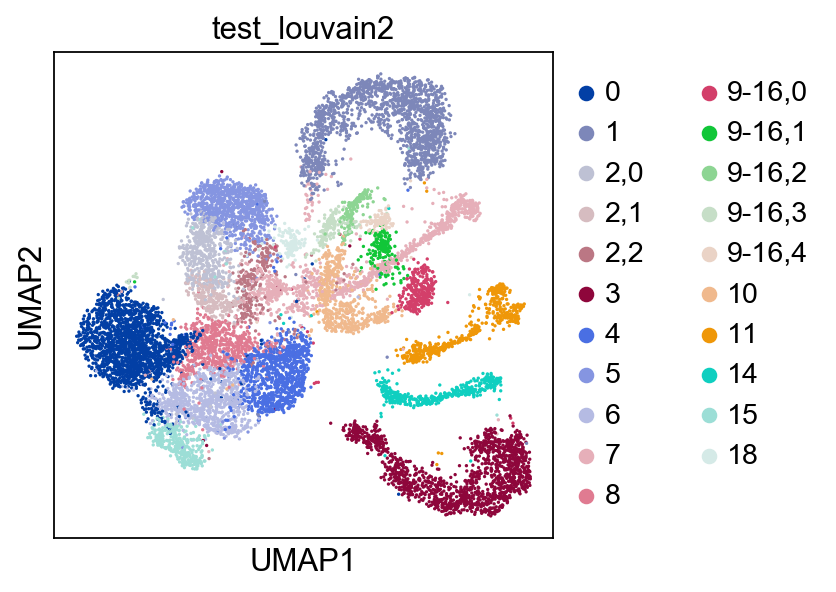

In [165]:
sc.tl.louvain(adata, resolution=0.2, restrict_to=['test_louvain', ['2']],
             key_added='test_louvain2')
sc.pl.umap(adata, color=['test_louvain2'])

... storing 'test_louvain2' as categorical


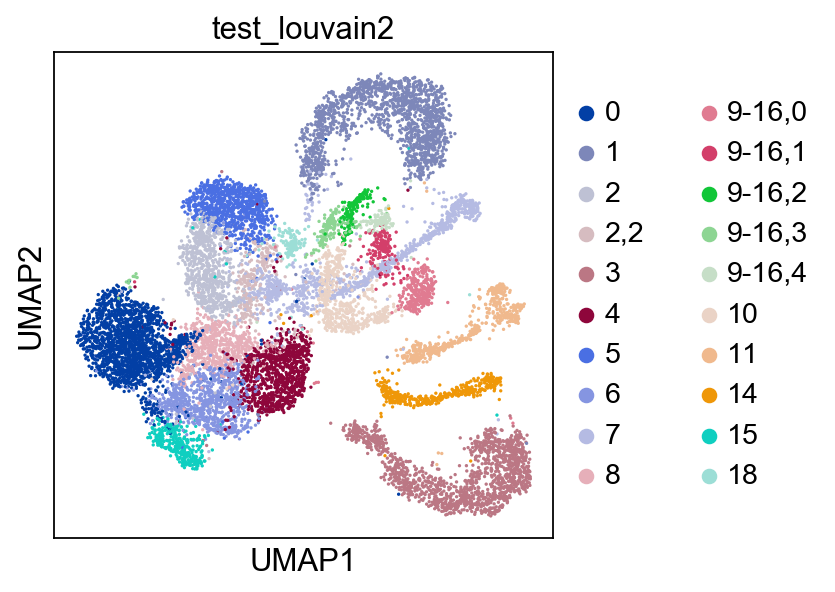

In [166]:
new_annot = []
for n in adata.obs['test_louvain2']:
    if n in ['2,0', '2,1']:
        new_annot.append('2')
    else:
        new_annot.append(n)
adata.obs['test_louvain2'] = new_annot
sc.pl.umap(adata, color=['test_louvain2'])

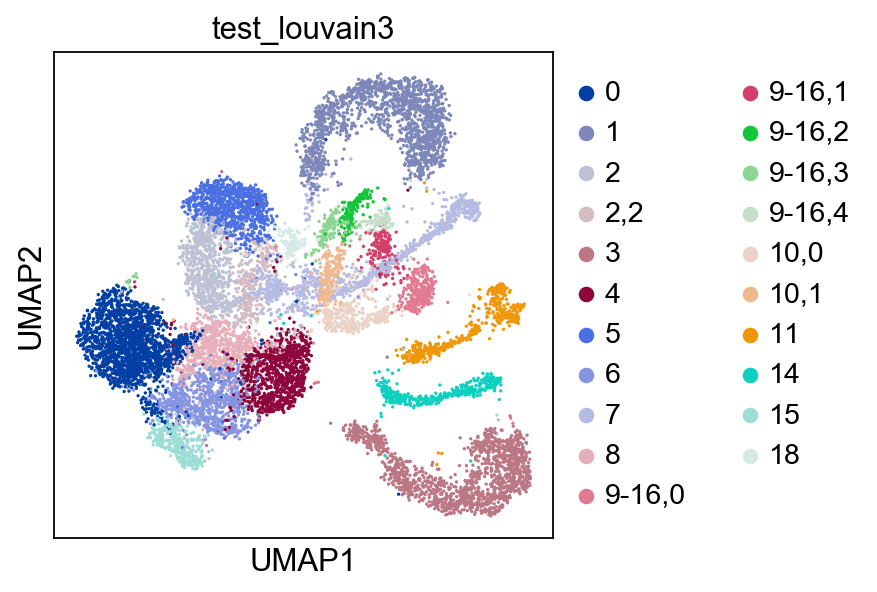

In [167]:
sc.tl.louvain(adata, resolution=0.1, restrict_to=['test_louvain2', ['10']],
             key_added='test_louvain3')
sc.pl.umap(adata, color=['test_louvain3'])

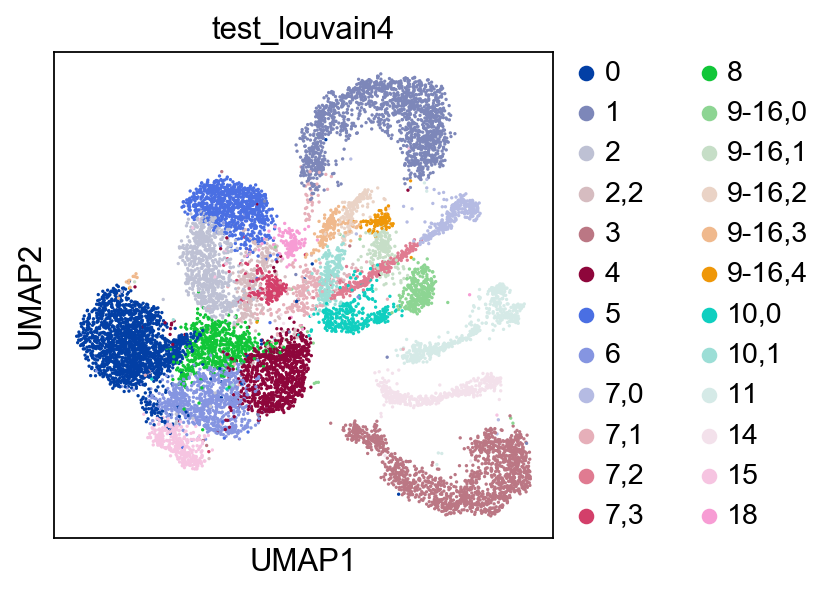

In [168]:
sc.tl.louvain(adata, resolution=0.3, restrict_to=['test_louvain3', ['7']],
             key_added='test_louvain4')
sc.pl.umap(adata, color=['test_louvain4'])

... storing 'test_louvain4' as categorical


saving figure to file ./figures/umapmerged_data_with_many_clusters.png


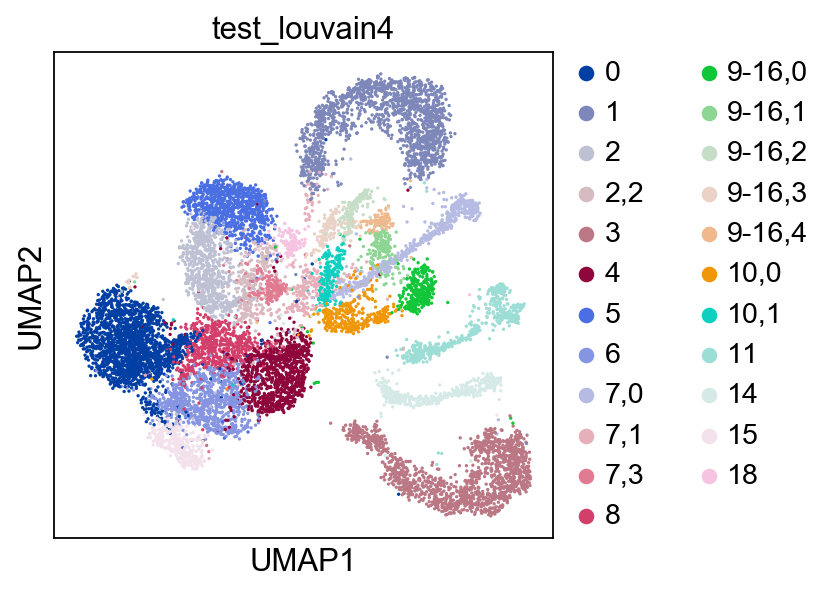

In [171]:
new_annot = []
for n in adata.obs['test_louvain4']:
    if n in ['7,0', '7,2']:
        new_annot.append('7,0')
    elif n in ['2,0', '2,1']:
        new_annot.append('2')
    else:
        new_annot.append(n)
adata.obs['test_louvain4'] = new_annot
sc.pl.umap(adata, color=['test_louvain4'], save='merged_data_with_many_clusters.png')

saving figure to file ./figures/umapmerged_data_with_many_many_clusters.png


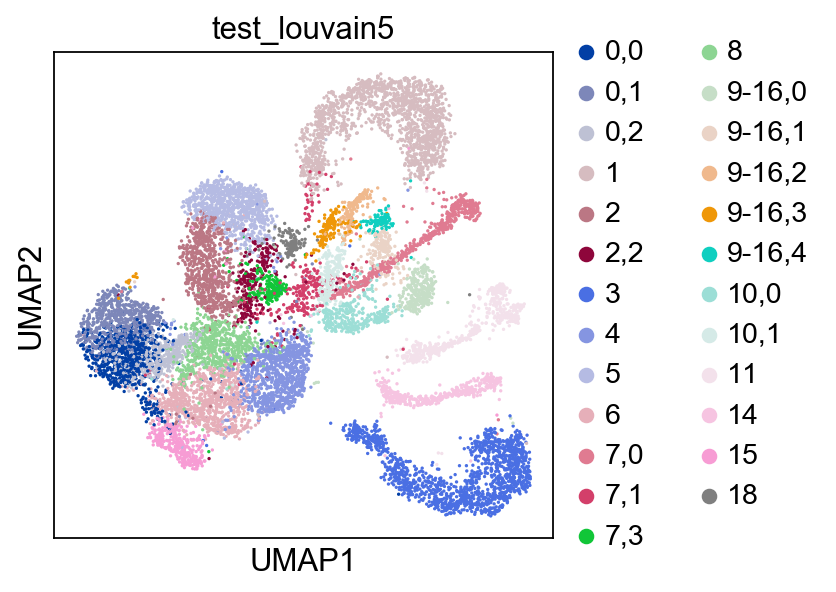

In [172]:
sc.tl.louvain(adata, resolution=0.3, restrict_to=['test_louvain4', ['0']],
             key_added='test_louvain5')
sc.pl.umap(adata, color=['test_louvain5'], save='merged_data_with_many_many_clusters.png')

['chr1:172270001-172275000', ' gene_name "Atp1a2"']
['chr1:172280001-172285000', ' gene_name "Atp1a2"']
['chr1:172295001-172300000', ' gene_name "Atp1a2"']
['chr1:172300001-172305000', ' gene_name "Atp1a2"']
['chr2:13570001-13575000', ' gene_name "Vim"']
['chr3:121720001-121725000', ' gene_name "F3"']
['chr1:172270001-172275000', ' gene_name "Atp1a2"']
['chr1:172280001-172285000', ' gene_name "Atp1a2"']
['chr1:172295001-172300000', ' gene_name "Atp1a2"']
['chr1:172300001-172305000', ' gene_name "Atp1a2"']
['chr16:18080001-18085000', ' gene_name "Prodh"']
['chr2:128735001-128740000', ' gene_name "Mertk"']
saving figure to file ./figures/umapastrocytes.png


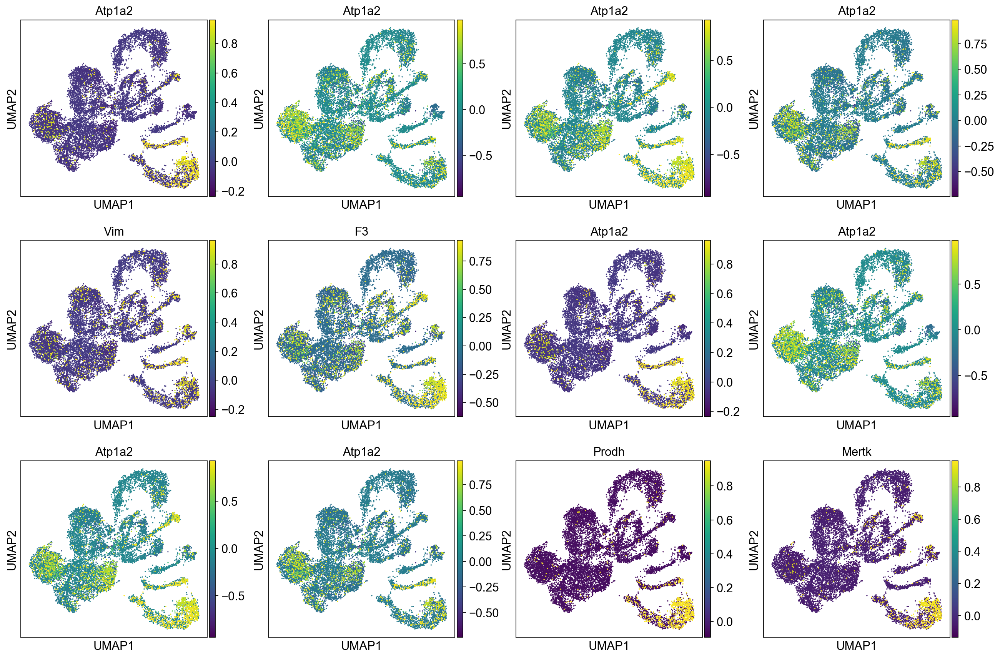

In [177]:
astrocytes = ['Ndrg2','S1pr1','Atp1a2','1110006G14Rik','Gas1',
              'Aldh1l1','Gja1','Slc01c1','S100B','Gfap',
             'Vim', 'Gfap']
astrocytes += ['Slc25ag18', 'Acsbg1', 'Ttpa', 'Cyp4f14', 'Chrdl1', 'Aldh1l1', 'Mlc1', 'Ppp1r3c','Aldoc', 'AU067665',
                'Slc39a12', 'Aqp4', 'Gfap', 'Slc15a2', 'Slc14a4', 'Plo2g7', 'Slc14a1', 'Rfx4', 'F3', 'Papss2',
              'Tmem166', 'Atp1a2', 'Tlr3', 'Prodh', 'Mertk', 'Cyp4f15', 'Ppp1r3g', 'Acot11', 'Gjb6', 
              'Slc1a2', 'Fzd2', 'Bmpr1b', 'Hapin1']

color_m= []
title_m = []
for m in astrocytes:
    for line in markers:
        if m in line[1]:
            print(line)
            color_m.append(line[0])
            title_m.append(line[1].split('"')[1])
            
sc.pl.umap(adata,
           color=color_m,
           title=title_m,
           save='astrocytes.png')

In [ ]:
['chr1:172270001-172275000', ' gene_name "Atp1a2"']
['chr16:18080001-18085000', ' gene_name "Prodh"']
['chr2:128735001-128740000', ' gene_name "Mertk"']

saving figure to file ./figures/umapastrocytes_top_markers_merged_data.png


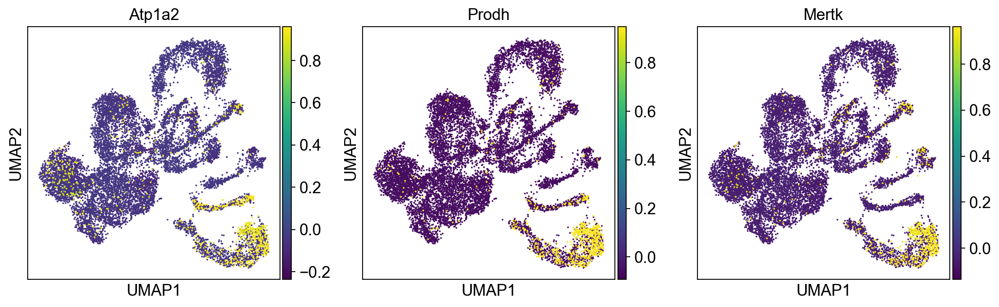

In [178]:
sc.pl.umap(adata, 
          color=['chr1:172270001-172275000', 'chr16:18080001-18085000', 'chr2:128735001-128740000'],
          title=['Atp1a2', 'Prodh', 'Mertk'],
          save='astrocytes_top_markers_merged_data.png')

saving figure to file ./figures/umapastrocytes_top_markers_10x_data.png


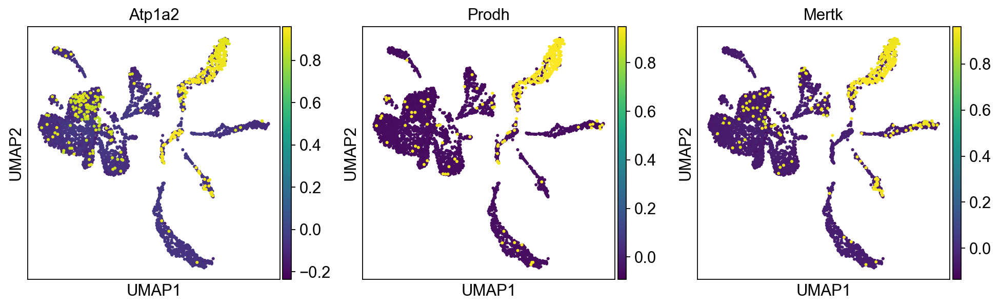

In [179]:
sc.pl.umap(adata_10x, 
          color=['chr1:172270001-172275000', 'chr16:18080001-18085000', 'chr2:128735001-128740000'],
          title=['Atp1a2', 'Prodh', 'Mertk'],
          save='astrocytes_top_markers_10x_data.png')

saving figure to file ./figures/umapastrocytes_top_markers_fang_data.png


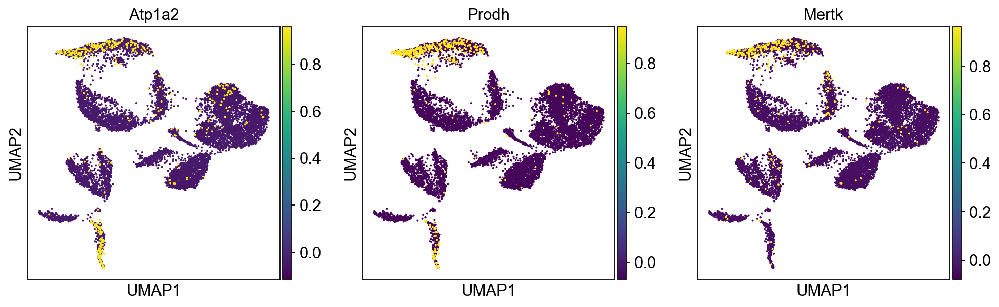

In [180]:
sc.pl.umap(adata_fang, 
          color=['chr1:172270001-172275000', 'chr16:18080001-18085000', 'chr2:128735001-128740000'],
          title=['Atp1a2', 'Prodh', 'Mertk'],
          save='astrocytes_top_markers_fang_data.png')

In [2]:
import anndata as ad
import scanpy.api as sc
import episcanpy.api as epi
import numpy as np
import bbknn
import time

%cd /Volumes/july_2019/snapatack

sc.settings.set_figure_params(dpi=80, dpi_save=400)

adata = sc.read('/Volumes/july_2019/snapatack/start_from_here_for_cell_id_july_17.h5ad')
adata

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters', 'post_bbknn_louvain', 'post_bbknn_louvain2'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'all_independent_clusters_colors', 'batch_colors', 'louvain', 'louvain_10x_colors', 'louvain_fang_colors', 'neighbors', 'pca', 'post_bbknn_louvain2_colors', 'post_bbknn_louvain_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [16]:
import time
def find_genes(adata, gtf_file_name, path='', extension=5000, key_added='gene_name'):
    start = time.time()
    with open(path+gtf_file_name) as f:
        gtf_raw = f.readlines()
    gtf = []
    for line in gtf_raw:
        if 'ERCC' not in line:
            if line[0] != '#':
                gtf.append(line[:-2].split('\t'))
    del gtf_raw
    
    print(time.time()-start)

    gtf_dic = {}
    for line in gtf:
        if line[0] not in gtf_dic.keys():
            gtf_dic[line[0]] = [line]
        else:
            gtf_dic[line[0]].append(line)
    del gtf
    print(time.time()-start)

    markers = []
    for w in adata.var_names:
        curr_m = []
        w2 = w.split(':')
        chrom = w2[0][3:]
        w2 = w2[1].split('-')
        w2 = [int(x) for x in w2]
        for gene in gtf_dic[chrom]:
            start = int(gene[3])-extension
            end = int(gene[4])+extension
            if (w2[0] < start < w2[1]) or (w2[0] < end < w2[1]):
                gene_name = gene[-1]
                for n in gene[-1].split(';'):
                    if 'gene_name' in n:
                        gene_name = n
                curr_m.append([w, gene_name])
        if curr_m != []:
            markers += curr_m

    markers = [list(x) for x in set(tuple(x) for x in markers)]
    print(time.time()-start)
    return(marker)

In [117]:
import time
import anndata as ad
# please run this function on an adata object sorted by feature coordinates.
# it is taking a lot of time (10minutes for 200000 features) to go through.

# You can give your adata + a gtf file and it will give you the matching genes
# within a windows (+ and - the extension argument).
# it can return a dictionary (var_names as keys and gene names as values)
def find_genes(adata, gtf_file_name, path='', extension=5000,
               key_added='gene_name', copy=True):
    start = time.time()
    #gtf = []
    gtf_dic = {}
    with open(path+gtf_file_name) as f:
        for line in f:
            if line[0] != '#':
                line = line[:-2].split('\t')
                if line[0] not in gtf_dic.keys():
                    gtf_dic[line[0]] = [line]
                else:
                    gtf_dic[line[0]].append(line)
    print(time.time()-start)

    markers = []
    previous_chrom = None
    for feature in adata.var_names.tolist():
        
        curr_m = []
        if ':' in feature: # if the feature is a granger coordinate.
            feature2 = feature.split(':')
            chrom = feature2[0][3:]
            w = [int(x) for x in feature2[1].split('-')]
        else:
            w = feature2.split('_')
        
        ## to (try to) save time by not going through all the features
        if chrom != previous_chrom:
            print(chrom, time.time()-start)
            curr_index = 0
        previous_chrom = chrom
        add_index =0
        
        # going through the genes in the gtf_dic:
        for gene in gtf_dic[chrom][curr_index:]:
            start = int(gene[3])-extension
            end = int(gene[4])+extension
            
            if (w[0] < start < w[1]) or (w[0] < end < w[1]):
                gene_name = gene[-1]
                for n in gene[-1].split(';'):
                    if 'gene_name' in n:
                        gene_name = n
                curr_m.append([feature, gene_name])
            elif start > w[1]:
                add_index += 1
            elif end>w[1]:
                curr_index += add_index
                break
                
        if curr_m != []:
            markers += curr_m

    print(time.time()-start)    
    marker_dict = {}
    for line in [list(x) for x in set(tuple(x) for x in markers)]:
        if line[0] not in marker_dict.keys():
            marker_dict[line[0]] = [line[1][:-1].split('"')[1]]
        else:
            marker_dict[line[0]].append([line[1][:-1].split('"')[1]])
            
    print(time.time()-start)
    annot = []
    for n in adata.var_names:
        if n in marker_dict:
            annot.append(marker_dict[n])
        else:
            annot.append(['NA'])
    adata.var[key_added] = annot
    print(time.time()-start)
    
    if copy==True:
        return(marker_dict)
    else:
        return()

In [118]:
adata

AnnData object with n_obs × n_vars = 13189 × 54539 
    obs: 'batch', 'n_genes', 'n_counts', 'louvain_10x', 'louvain_fang', 'all_independent_clusters', 'post_bbknn_louvain', 'post_bbknn_louvain2'
    var: 'overlap10x-0', 'chrom-1', 'chrom2-1', 'n_cells-1', 'n_cells'
    uns: 'all_independent_clusters_colors', 'batch_colors', 'louvain', 'louvain_10x_colors', 'louvain_fang_colors', 'neighbors', 'pca', 'post_bbknn_louvain2_colors', 'post_bbknn_louvain_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [ ]:
annot = find_genes(adata, 'mmGRCm38.93.ERCC92.gtf',
               path='/Volumes/july_2019/july12_2019/',
               extension=10000, key_added='gene_name_1',
                  copy=True)

In [100]:
len(markers)

6540

In [107]:
marker_dict = {}
for line in [list(x) for x in set(tuple(x) for x in markers)]:
    if line[0] not in marker_dict.keys():
        marker_dict[line[0]] = [line[1][:-1].split('"')[1]]
    else:
        marker_dict[line[0]] += [line[1][:-1].split('"')[1]]

In [103]:
dico = marker_dict.keys()

In [ ]:
#genes = []
#for n in markers:
#    genes.append(n[1].split('"')[1])

m = 'Slc17a7'
for line in markers:
    if m in line[1]:
        print(line)

m = 'Gad2'
for line in markers:
    if m in line[1]:
        print(line)

sc.pl.umap(adata,
           color=['chr7:45165001-45170000', 'chr2:22620001-22625000'],
           title=['Slc17a7', 'Gad2'],
           save='inhibitory_excitatory_neurons.png')
